Optical properties of responsive hybrid Au@polymer nanoparticles
========

Must change title eventually

Supporting information - data analysis: peak analysis
--------

Abstract
--------

We take a close look at the physical and optical properties of Au@PNIPAM core-shell nanoparticles.  
- Small cores $\sim$8 nm
- Large range of shell thickness: $[16, 193]$ nm
- PNIPAM is thermally responsive
  - Swells with decreasing temperature
    - $\downarrow T \equiv \uparrow R_{\mathrm{shell}}$ 
  - Decrease in refractive index with decreasing temperature: 
    - $\downarrow T \equiv \downarrow n_{\mathrm{shell}}$  

The LSPR peak wavelength shifts with decreasing temperature
  - Small shells show a blue-shift
    - due to $\downarrow n_{\mathrm{shell}}$
  - Large shells show almost no shift
    - Scattering counteracts blue-shift
    - Background subtraction reveals blue-shift
      - similar magnitude shift to thin shells  

Scattering follows a power law relationship $C_{\mathrm{ext}} = \kappa \lambda^{\eta}$
  - LSPR peak wavelength difficult to identify for large scattering
    - Scattering background must be accounted
    - Simple polynomial not sufficient
  - Exponent $\eta$ changes with wavelength $\lambda$ and shell size
    - Thick/high-RI shells are not Mie scatterers ($\sim\lambda^{-4}$)
    - Exponent nearly constant over a small wavelength range
      - Here we use the range $[450, 650]$ nm centered on the Au LSPR peak wavelength $\sim$ 525 nm
      - LSPR also shows increased extinction with shorter wavelengths
        - 'False' power law background has exponent $\eta_{\mathrm{LSPR}} \sim 5$
        - Add (scaled) LSPR background to account for false subtraction 
  - Power law exponent varies between $\sim$0 and $\sim$3
    - Scattering from thin shells overwhelmed by LSPR
    - Largest shells fit power law exponent $\eta_{\mathrm{shell}} \sim 3$
    

# Initialize analysis

## Initialize computational/python framework

In [1]:
%run "header.py"

Loading import modules ...
  ... math, cmath (local)
  ... os, sys, types, importlib
  ... time, datetime
  ... ipyparallel as ipp
  ... numpy as np
  ... scipy as sp
      scipy.special (local, for Bessel functions)
      scipy.interpolate as interpolate
      scipy.signal as signal
  ... matplotlib
      matplotlib.pyplot as plt
      matplotlib.cm as cm
      matplotlib.pylab as pylab
  ... sympy
  ... peakutils
Defining fundamental constants ...
  ... Avogadro's number: 'AvogadroN'
  ... speed of light: 'cumfs','cnmfs'
  ... Planck's constant: 'heVfs','hbareVfs'
  ... electron rest mass: 'eMass0eVnmfs'
  ... permittivity of free space: 'eps0enmV'
Loading analysis codes ... 
  ... refractive index functions loaded:
       Au, Ag, SiO2, ITO, ZnO, H2O, 
       ethanol, CS2, benzene, toluene, 
       chloroform, methanol, butanol, 
       propanol
  ... Mie functions loaded
Ready player one.


## Import data

### Raw data

In [2]:
%run -i header_import_data

Loading import modules ...
  ... math, cmath (local)
  ... os, sys, types, importlib
  ... time, datetime
  ... ipyparallel as ipp
  ... numpy as np
  ... scipy as sp
      scipy.special (local, for Bessel functions)
      scipy.interpolate as interpolate
      scipy.signal as signal
  ... matplotlib
      matplotlib.pyplot as plt
      matplotlib.cm as cm
      matplotlib.pylab as pylab
  ... sympy
  ... peakutils
Defining fundamental constants ...
  ... Avogadro's number: 'AvogadroN'
  ... speed of light: 'cumfs','cnmfs'
  ... Planck's constant: 'heVfs','hbareVfs'
  ... electron rest mass: 'eMass0eVnmfs'
  ... permittivity of free space: 'eps0enmV'
Loading analysis codes ... 
  ... refractive index functions loaded:
       Au, Ag, SiO2, ITO, ZnO, H2O, 
       ethanol, CS2, benzene, toluene, 
       chloroform, methanol, butanol, 
       propanol
  ... Mie functions loaded
Ready player one.
Import and organize data
Linear PNIPAM: 
Importing data in folder data_20160905 ...
  * Au-linP

# Peak analysis: No scattering baseline correction

## Peak analysis

### Core only

In [3]:
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 35
nPeaks = 1
wlMin0nm, wlMax0nm = wlExpectednm-2*dwlExpectednm, wlExpectednm+2*dwlExpectednm
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier = "_lspr-core-peaks"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'Rcore-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Bare cores only')
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('  * peaks detected: \n    wl-nm (interp),\t [wl-nm,  ext]')

lsprPeakWLnmCoreList = []
for sampleNum in range(2):
    sampleType = (['L-Core_D=','X-Core_D='][sampleNum]) + str(int(round(2*coreRnms[sampleNum]))) + '-nm'
    print('   - Core #',sampleNum,'(',
          sampleType,
          ')')
    subdataArray = spectraCores[sampleNum]
    selection = ((subdataArray[:,0] >= wlMin0nm) 
                 & (subdataArray[:,0] <= wlMax0nm)
                 )
    subdataArray = subdataArray[selection]
    minDist = int(subdataArray.size/(nPeaks+1))
    x, y = subdataArray[:,0], subdataArray[:,1]
    indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
    xPeaks = x[indexes]
    anArray = (np.array([xPeaks, indexes])).T
    selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
    indexes = (anArray[selection][:,1]).tolist()
    xPeaks = x[indexes]
    if (len(indexes) > 0): 
        result = subdataArray[indexes[0]]
        xPeaks = peakutils.interpolate(x, y, indexes)
        print('   ', round(100*xPeaks[0])/100,',\t\t',  
              (np.round(100*result)/100).tolist())
        result = [xPeaks[0], coreRnms[sampleNum]]
        lsprPeakWLnmCoreList.append(result)

lsprPeakWLnmCoreArray = np.asarray(lsprPeakWLnmCoreList)
filename = folder + timestamp + identifier + exportFormat
# np.savetxt(filename, lsprPeakWLnmCoreList, delimiter='\t', header=datHeader, fmt='%.2f')
# print('     + saved to', filename) 

print("  * output array \"lsprPeakWLnmCoreArray\" format: \n    [ peak-wl-nm, Rcore-nm]")


LSPR peak wavelengths
Bare cores only
  * looking for one peak at 525 nm 
    - in the range [ 490 , 560 ] nm
  * peaks detected: 
    wl-nm (interp),	 [wl-nm,  ext]
   - Core # 0 ( L-Core_D=17-nm )
    519.72 ,		 [519.0, 1.1]
   - Core # 1 ( X-Core_D=13-nm )
    517.55 ,		 [518.0, 1.44]
  * output array "lsprPeakWLnmCoreArray" format: 
    [ peak-wl-nm, Rcore-nm]


### Core-shell

In [4]:
threshold = 0.05
wlExpectednm = 515
dwlExpectednm = 25
nPeaks = 1
wlMin0nm, wlMax0nm = wlExpectednm-2*dwlExpectednm, wlExpectednm+2*dwlExpectednm
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier0 = "lspr-peaks"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'temp-C', 'Rh-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('  * peaks detected: \n    wl-nm (interp),\t [wl-nm,  ext,  temp-C,  Rh-nm]')

lsprPeakWLnmList = []
for sampleNum in range(6):
    sampleType = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
    print('   - Sample #',sampleNum,'(',
          sampleType,
          ')')
    lsprPeakWLnmSubList = []
    for T in spectraTemps[sampleNum]:
        selection = ((dataArray[:,-1] == sampleNum) 
                     & (dataArray[:,-3] == T)
                     & (dataArray[:,0] >= wlMin0nm) 
                     & (dataArray[:,0] <= wlMax0nm)
                     )
        subdataArray = dataArray[selection]
        minDist = int(subdataArray.size/(nPeaks+1))
        x, y = subdataArray[:,0], subdataArray[:,1]
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = (anArray[selection][:,1]).tolist()
        xPeaks = x[indexes]
        if (len(indexes) > 0): 
            result = subdataArray[indexes[0]]
            xPeaks = peakutils.interpolate(x, y, indexes)
            print('   ', round(100*xPeaks[0])/100,',\t\t',  
              (np.round(100*result[0:-1])/100).tolist())
            result = [xPeaks[0], result[-3], result[-2], int(result[-1])]
            lsprPeakWLnmList.append(result)
            result = [xPeaks[0], result[-3], result[-2]]
            lsprPeakWLnmSubList.append(result)
        else: # using negative curvature method
            x1 = 0.25*x[:-2] + 0.5*x[1:-1] + 0.25*x[2:]
            x1 = np.concatenate((x1, 0.5*x[:-1] + 0.5*x[1:]))
            y1 = 0.25*y[:-2] + 0.5*y[1:-1] + 0.25*y[2:]
            y1 = np.concatenate((y1, 0.5*y[:-1] + 0.5*y[1:]))
            sort = np.argsort(x1)
            x1, y1 = x1[sort], y1[sort]
            
            dy = np.gradient(y1, np.diff(x1)[0])
            ddy = np.gradient(dy, np.diff(x1)[0])
            select = ((ddy <= 0) & (x1 > 500) & (x1 < 535))
            x2, y2 = x1[select], y1[select]
            xPeaks = [np.mean(x2)]
            
            indexes = np.arange(len(x))[np.argsort(np.abs(x - xPeaks[0]))][[0]] 
            result = subdataArray[indexes[0]]
            print('   ', round(100*xPeaks[0])/100,',\t\t',  
              (np.round(100*result[0:-1])/100).tolist())
            result = [xPeaks[0], result[-3], result[-2], int(result[-1])]
            lsprPeakWLnmList.append(result)
            result = [xPeaks[0], result[-3], result[-2]]
            lsprPeakWLnmSubList.append(result)
            
    if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
    lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)
    identifier = '_' + identifier0 + '_' + str(sampleNum) + '-' + sampleType
    filename = folder + timestamp + identifier + exportFormat
#     np.savetxt(filename, lsprPeakWLnmSubList, delimiter='\t', header=datHeader, fmt='%.2f')
#     print('      + saved to', filename) 

lsprPeakWLnmArray = np.asarray(lsprPeakWLnmList)
print("  * output array \"lsprPeakWLnmArray\" format: \n    [ peak-wl-nm, temp-C, Rh-nm, sample-# ]")
print("    - sample-# = [0,...,5] \n      for [lin-Thin, lin-Med., lin-Long, X-Thin, X-Med., X-Long]")


LSPR peak wavelengths
  * looking for one peak at 515 nm 
    - in the range [ 490 , 540 ] nm
  * peaks detected: 
    wl-nm (interp),	 [wl-nm,  ext,  temp-C,  Rh-nm]
   - Sample # 0 ( L1-Thn )
    523.45 ,		 [525.0, 0.69, 15.0, 24.77]
    523.68 ,		 [524.0, 0.69, 20.0, 23.19]
    523.97 ,		 [526.0, 0.69, 25.0, 23.8]
    524.12 ,		 [527.0, 0.7, 27.0, 23.82]
    524.17 ,		 [524.0, 0.7, 29.0, 23.4]
    524.52 ,		 [524.0, 0.7, 31.0, 21.81]
    524.54 ,		 [525.0, 0.7, 33.0, 20.67]
    524.61 ,		 [524.0, 0.7, 35.0, 20.93]
    524.91 ,		 [524.0, 0.7, 40.0, 18.58]
    525.13 ,		 [527.0, 0.7, 45.0, 18.12]
    525.06 ,		 [526.0, 0.69, 50.0, 17.66]
    524.95 ,		 [527.0, 0.69, 55.0, 18.62]
    525.07 ,		 [526.0, 0.68, 60.0, 17.88]
   - Sample # 1 ( L2-Med )
    523.4 ,		 [525.0, 0.49, 15.0, 43.2]
    523.71 ,		 [525.0, 0.49, 20.0, 41.89]
    523.9 ,		 [524.0, 0.5, 25.0, 39.28]
    524.08 ,		 [525.0, 0.5, 27.0, 37.99]
    524.4 ,		 [526.0, 0.5, 29.0, 36.91]
    524.79 ,		 [524.0, 0.5, 31.0, 33.89

### Core-shell, method development for large scattering

First, smoothing the data, then using second derivative to calculate region with negative curvature. Last, finding the middle (mean) of this region.

LSPR peak wavelengths
  * looking for one peak at 515 nm 
    - in the range [ 490 , 540 ] nm
  * peaks detected: 
    wl-nm (interp),	 [wl-nm,  ext,  temp-C,  Rh-nm]
   - Sample # 4 ( X2-Med )
520.029411765 521.0
   	 ,		 [465.0, 0.28, 7.65, 144.22]
520.039215686 521.0
   	 ,		 [465.0, 0.29, 9.96, 143.8]
519.365384615 520.25
   	 ,		 [465.0, 0.29, 13.81, 142.45]
520.055555556 520.75
   	 ,		 [465.0, 0.29, 17.66, 137.13]
519.19 519.75
   	 ,		 [465.0, 0.3, 21.51, 133.86]
518.869565217 519.25
   	 ,		 [465.0, 0.3, 25.36, 129.83]
518.4375 518.75
   	 ,		 [465.0, 0.31, 27.67, 125.59]
520.520833333 520.75
   	 ,		 [465.0, 0.31, 28.44, 123.41]
518.403846154 518.75
   	 ,		 [465.0, 0.32, 29.21, 121.04]
520.471153846 521.25
   	 ,		 [465.0, 0.32, 29.98, 118.82]
520.012195122 520.0
   	 ,		 [465.0, 0.33, 30.75, 117.11]
520.670212766 522.0
   	 ,		 [465.0, 0.33, 31.52, 117.11]
518.520408163 519.5
   	 ,		 [465.0, 0.34, 32.29, 114.44]
518.877777778 519.5
   	 ,		 [465.0, 0.35, 33.06, 112.09]
518

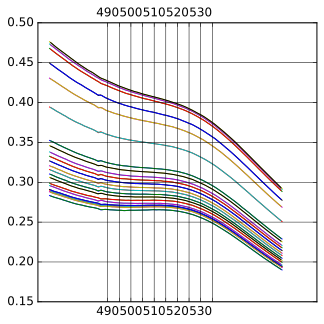

   - Sample # 5 ( X3-Thk )
518.62195122 519.0
   	 ,		 [465.0, 0.33, 7.65, 191.37]
519.1 519.25
   	 ,		 [465.0, 0.34, 9.96, 189.35]
519.355263158 519.75
   	 ,		 [465.0, 0.33, 13.81, 184.22]
519.243589744 521.5
   	 ,		 [465.0, 0.34, 17.66, 181.62]
519.292682927 519.5
   	 ,		 [465.0, 0.35, 21.51, 176.84]
518.3625 518.25
   	 ,		 [465.0, 0.36, 25.36, 169.52]
518.986842105 518.25
   	 ,		 [465.0, 0.37, 27.67, 162.81]
519.26744186 519.0
   	 ,		 [465.0, 0.38, 28.44, 162.81]
519.763157895 520.25
   	 ,		 [465.0, 0.39, 29.21, 160.21]
518.828947368 520.0
   	 ,		 [465.0, 0.39, 29.98, 156.22]
519.666666667 519.0
   	 ,		 [465.0, 0.4, 30.75, 151.35]
519.0 521.0
   	 ,		 [465.0, 0.41, 31.52, 151.35]
519.513157895 519.75
   	 ,		 [465.0, 0.42, 32.29, 147.11]
519.135135135 519.5
   	 ,		 [465.0, 0.43, 33.06, 142.64]
517.9875 517.5
   	 ,		 [465.0, 0.44, 33.83, 138.34]
518.242424242 519.5
   	 ,		 [465.0, 0.51, 36.91, 128.38]
519.897435897 521.5
   	 ,		 [465.0, 0.56, 40.76, 121.41]
518.85897435

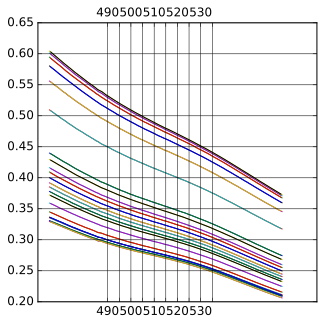

In [5]:
threshold = 0.05
wlExpectednm = 515
dwlExpectednm = 25
nPeaks = 1
wlMin0nm, wlMax0nm = wlExpectednm-2*dwlExpectednm, wlExpectednm+2*dwlExpectednm
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier0 = "lspr-peaks"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'temp-C', 'Rh-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('  * peaks detected: \n    wl-nm (interp),\t [wl-nm,  ext,  temp-C,  Rh-nm]')

lsprPeakWLnmList = []
for sampleNum in range(4, 6):
    sampleType = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
    print('   - Sample #',sampleNum,'(',
          sampleType,
          ')')
    lsprPeakWLnmSubList = []
    i = 0
    for T in spectraTemps[sampleNum]:
        selection = ((dataArray[:,-1] == sampleNum) 
                     & (dataArray[:,-3] == T)
                     & (dataArray[:,0] >= wlMin0nm) 
                     & (dataArray[:,0] <= wlMax0nm)
                     )
        subdataArray = dataArray[selection]
        minDist = int(subdataArray.size/(nPeaks+1))
        x, y = subdataArray[:,0], subdataArray[:,1]
        pylab.plot(x, y)
        x1 = 0.25*x[:-2] + 0.5*x[1:-1] + 0.25*x[2:]
        x1 = np.concatenate((x1, 0.5*x[:-1] + 0.5*x[1:]))
        y1 = 0.25*y[:-2] + 0.5*y[1:-1] + 0.25*y[2:]
        y1 = np.concatenate((y1, 0.5*y[:-1] + 0.5*y[1:]))
        sort = np.argsort(x1)
        x1, y1 = x1[sort], y1[sort]
        pylab.plot(x1, y1)
        
        dy = np.gradient(y1, np.diff(x1)[0])
        ddy = np.gradient(dy, np.diff(x1)[0])
        select = ((ddy <= 0) & (x1 > 500) & (x1 < 535))
        x2, y2 = x1[select], y1[select]
        print(np.mean(x2), np.median(x2))
        
        
        print('   \t',',\t\t',  
          (np.round(100*subdataArray[0,0:-1])/100).tolist())
        
    xticks = np.arange(wlMinnm, wlMaxnm, 5)
    xtickslabeled = np.arange(10*ceil(wlMinnm/10), wlMaxnm, 10)
    xticklabels = xticks.astype(str)
    for i in range(len(xticks)):
        if (xticks[i] not in xtickslabeled): xticklabels[i] = ''
    pylab.xticks(xticks, xticklabels)
        
    ax = pylab.gca()
    ax.xaxis.set_tick_params(labeltop='on')
    pylab.grid(linestyle='-')
    pylab.show()
        


## Peak wavelength vs temperature plots

### Individually with cores

All samples: peak LSPR wavelength vs temperature
Individually with Au core in red for reference


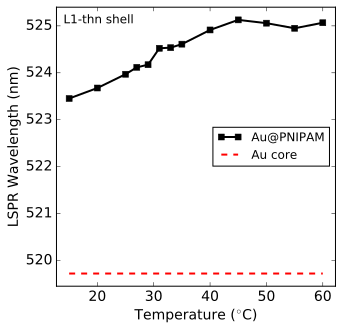

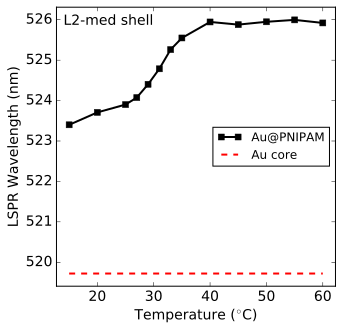

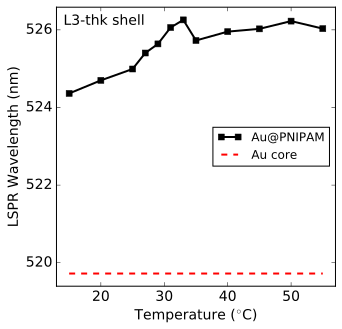

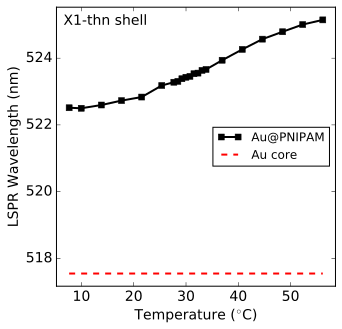

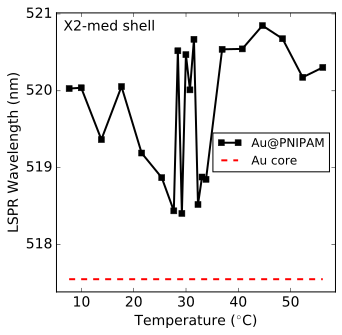

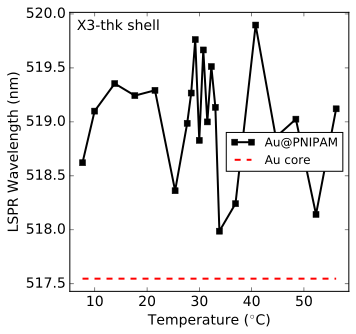

In [6]:
exportFlag = False
print('All samples: peak LSPR wavelength vs temperature')
print('================================================')
print('Individually with Au core in red for reference')
def plotAndSave (sampleNum):   
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    sampleLabel = spectrumNames[sampleNum]+' shell'
    
    # data set 1
    label = 'Au@PNIPAM'
    color = 'black'
    marker = 's'
    line = '-'
    selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPeakWLnmArray[selection]
    x, y = plotArray[:,1], plotArray[:,0]
    if x.size == 0:
        print('  ' + sampleLabel + ': No data!')
        return
    xs, ys, labels, colors, markers, lines = [x], [y], [label], [color], [marker], [line]
    
    # data set 2
    label = 'Au core'
    color = 'red'
    marker = ''
    line = '--'
    if sampleNum < 3: plotArray = lsprPeakWLnmCoreList[0]
    else: plotArray = lsprPeakWLnmCoreList[1]
    x, y = [], []
    for T in xs[0]: x.append(T); y.append(plotArray[0])
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Temperature ($^{\circ}$C)')
    pylab.ylabel("LSPR Wavelength (nm)")
    figText = sampleLabel
    pylab.text(xLimits[0]+0.025*dx, yLimits[1]-0.025*dy, figText, verticalalignment='top', horizontalalignment='left')
    pylab.legend(loc='center right', fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-T_" + spectrumNames[sampleNum])
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
for sampleNum in range(6):
    plotAndSave(sampleNum) 


### Together with cores

All samples: peak LSPR wavelength vs temperature
Together with Au cores in black/gray for reference


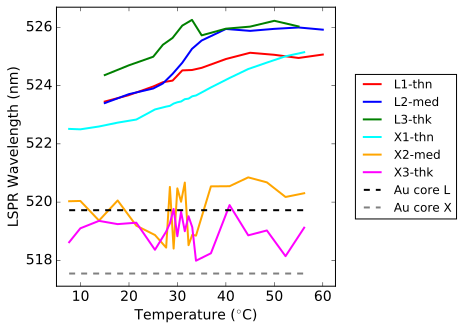

In [6]:
exportFlag = False
print('All samples: peak LSPR wavelength vs temperature')
print('================================================')
print('Together with Au cores in black/gray for reference')
def plotAndSave ():   
    pylab.cla()
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = spectrumNames[sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = (['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPeakWLnmArray[selection]
        x, y = plotArray[:,1], plotArray[:,0]
        if x.size > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
        else: print('  ' + label + ': No data!')
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = ''
        line = '--'
        plotArray = lsprPeakWLnmCoreList[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(T); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], #marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Temperature ($^{\circ}$C)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-T_all" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores

All samples: peak LSPR wavelength vs temperature
Together with Au cores in black/gray for reference


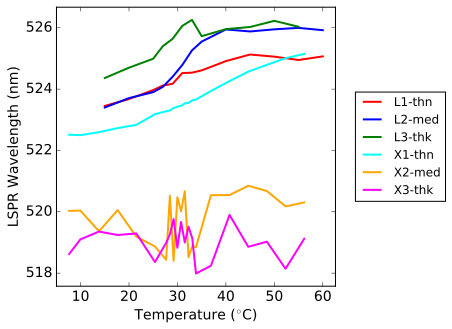

In [7]:
exportFlag = False
print('All samples: peak LSPR wavelength vs temperature')
print('================================================')
print('Together with Au cores in black/gray for reference')
def plotAndSave ():   
    pylab.cla()
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = spectrumNames[sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = (['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPeakWLnmArray[selection]
        x, y = plotArray[:,1], plotArray[:,0]
        if x.size > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
        else: print('  ' + label + ': No data!')
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = ''
        line = '--'
        plotArray = lsprPeakWLnmCoreList[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(T); y.append(plotArray[0])
        #xs.append(x), ys.append(y), labels.append(label)
        #colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], #marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Temperature ($^{\circ}$C)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-T_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

## Peak wavelength vs hydrodynamic radius $R_h$ plots

### Individually with cores

All samples: peak LSPR wavelength vs  hydrodynamic radius
Individually with Au core in red for reference


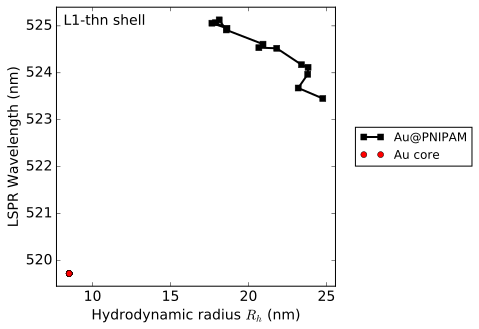

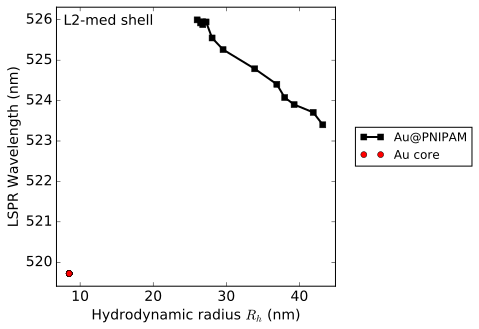

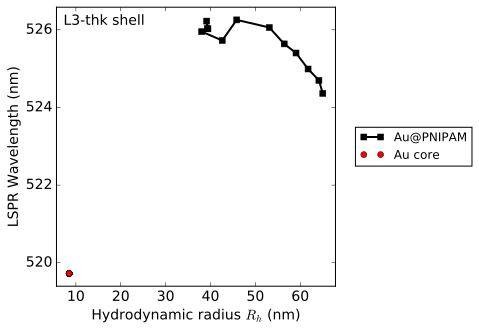

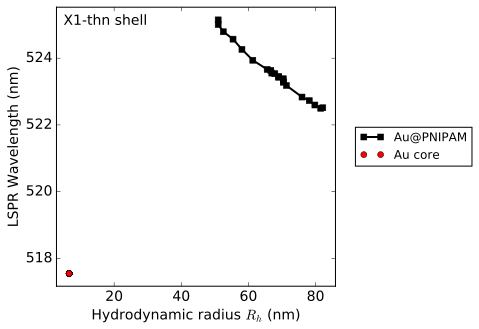

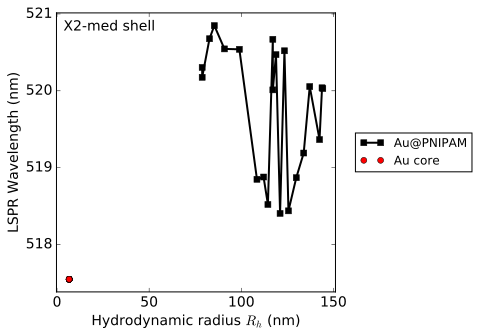

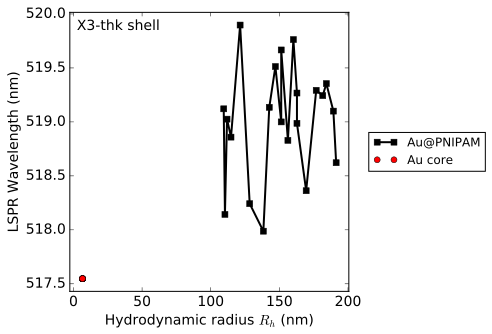

In [69]:
exportFlag = False
print('All samples: peak LSPR wavelength vs  hydrodynamic radius')
print('================================================')
print('Individually with Au core in red for reference')
def plotAndSave (sampleNum):   
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    sampleLabel = spectrumNames[sampleNum]+' shell'
    
    # data set 1
    label = 'Au@PNIPAM'
    color = 'black'
    marker = 's'
    line = '-'
    selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPeakWLnmArray[selection]
    x, y = plotArray[:,2], plotArray[:,0]
    if x.size == 0:
        print('  ' + sampleLabel + ': No data!')
        return
    xs, ys, labels, colors, markers, lines = [x], [y], [label], [color], [marker], [line]
    
    # data set 2
    label = 'Au core'
    color = 'red'
    marker = 'o'
    line = ''
    if sampleNum < 3: 
        plotArray = lsprPeakWLnmCoreList[0]
        Rnm = coreRnms[0]
    else: 
        plotArray = lsprPeakWLnmCoreList[1]
        Rnm = coreRnms[1]
    x, y = [], []
    for T in xs[0]: x.append(Rnm); y.append(plotArray[0])
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    figText = sampleLabel
    pylab.text(xLimits[0]+0.025*dx, yLimits[1]-0.025*dy, figText, verticalalignment='top', horizontalalignment='left')
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ( "_lspr-vs-Rh_" + spectrumNames[sampleNum] )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
for sampleNum in range(6):
    plotAndSave(sampleNum) 


### Together with cores

All samples: peak LSPR wavelength vs hydrodynamic radius
Together with Au cores in black/gray for reference


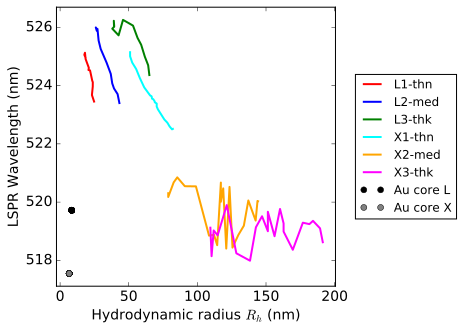

In [70]:
exportFlag = False
print('All samples: peak LSPR wavelength vs hydrodynamic radius')
print('================================================')
print('Together with Au cores in black/gray for reference')
def plotAndSave ():   
    pylab.cla()
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = spectrumNames[sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = ''#(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPeakWLnmArray[selection]
        x, y = plotArray[:,2], plotArray[:,0]
        if x.size > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
        else: print('  ' + label + ': No data!')
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-Rh_all" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores

All samples: peak LSPR wavelength vs hydrodynamic radius
Together without Au cores in black/gray for reference


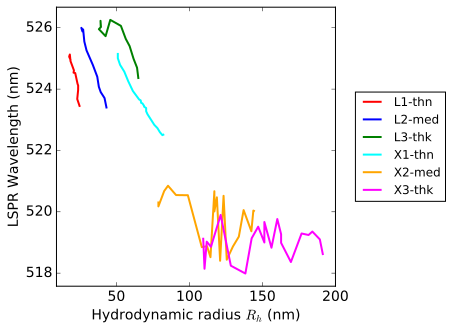

In [71]:
exportFlag = False
print('All samples: peak LSPR wavelength vs hydrodynamic radius')
print('================================================')
print('Together without Au cores in black/gray for reference')
def plotAndSave ():   
    pylab.cla()
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = spectrumNames[sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = ''#(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPeakWLnmArray[selection]
        x, y = plotArray[:,2], plotArray[:,0]
        if x.size > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
        else: print('  ' + label + ': No data!')
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        #xs.append(x), ys.append(y), labels.append(label)
        #colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-Rh_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

## Hydrodynamic radius vs peak wavelength plots

### Together with cores

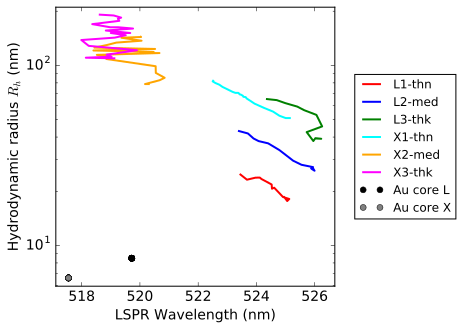

In [72]:
exportFlag = False
def plotAndSave ():   
    pylab.cla()
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = spectrumNames[sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = ''#(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPeakWLnmArray[selection]
        x, y = plotArray[:,2], plotArray[:,0]
        if x.size > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
        else: print('  ' + label + ': No data!')
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(ys[setNum], xs[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(ys[setNum][i]); y.append(xs[setNum][i])
    y.append(np.min(spectraRhnms[0]))
    y.append(np.max(spectraRhnms[-1]))
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [0.9*np.amin(y), 1.1*np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.xlabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    #pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_Rh-vs-lspr_all" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores

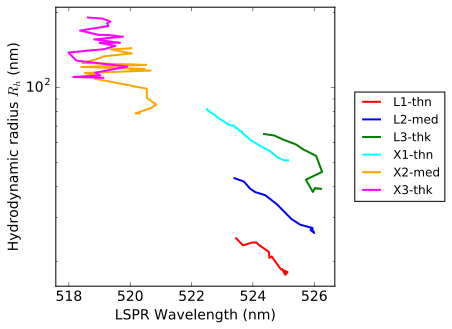

In [73]:
exportFlag = False
def plotAndSave ():   
    pylab.cla()
    spectrumNames = ['L1-thn','L2-med','L3-thk','X1-thn','X2-med','X3-thk']
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = spectrumNames[sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = ''#(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPeakWLnmArray[selection]
        x, y = plotArray[:,2], plotArray[:,0]
        if x.size > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
        else: print('  ' + label + ': No data!')
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        #xs.append(x), ys.append(y), labels.append(label)
        #colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(ys[setNum], xs[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(ys[setNum][i]); y.append(xs[setNum][i])
    y.append(np.min(spectraRhnms[0]))
    y.append(np.max(spectraRhnms[-1]))
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [0.9*np.amin(y), 1.1*np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.xlabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    # pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-Rh_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

# Peak Analysis: Power law baseline for scattering correction

## Peak analysis

### Core only

In [5]:
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 25
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier = "_lspr-core-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'wl-orig-nm', 'Rcore-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Bare cores only')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm (interp),\t [wl-nm, ext], \t (orig wl-nm)')

lsprPowrPeakWLnmCoreList = []
lsprPowrBaselineCoreList = []
lsprPowrBaselineCorenkList = []
for sampleNum in range(2):
    sampleType = (['L-Core_D=','X-Core_D='][sampleNum]) + str(int(round(2*coreRnms[sampleNum]))) + '-nm'
    print('  * Core #',sampleNum,'(', sampleType, ')', end="")
    
    subdataArray = spectraCores[sampleNum]
    selection = ((subdataArray[:,0] >= wlMin0nm) 
                 & (subdataArray[:,0] <= wlMax0nm)
                 )
    subdataArray = subdataArray[selection]
    minDist = int(subdataArray.size/(nPeaks+1))
    
    x, y = subdataArray[:,0], subdataArray[:,1]
    yOrig = y
    logx, logy = np.log(x/x0base), np.log(y)
    dlogx = min(np.diff(logx))
    loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
    loglogy = np.interp(loglogx, logx, logy)
    
    loglogyLinBase = peakutils.baseline(loglogy, 1)
    logyLinBase = np.interp(logx, loglogx, loglogyLinBase)
    loglogfit = np.polyfit(logx, logyLinBase, 1)
    basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])
    print('\t{baseline n =', '{0:.2f}'.format(basePowrn),', k =', '{0:.1f}'.format(baseCoeffk),'}')
    
    yPowrBase = (np.exp(logyLinBase))
    y = y - yPowrBase
    
    indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
    xPeaks = x[indexes]
    anArray = (np.array([xPeaks, indexes])).T
    selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
    indexes = (anArray[selection][:,1]).tolist()
    xPeaks = x[indexes]
    if (len(indexes) > 0): 
        result = subdataArray[indexes[0]]
        xPeaks = peakutils.interpolate(x, y, indexes)
        print('   ', round(100*xPeaks[0])/100,',\t\t',  
              (np.round(100*result)/100).tolist(),
              '\t (', round(100*lsprPeakWLnmCoreList[sampleNum][0])/100,')')
        result = [xPeaks[0], lsprPeakWLnmCoreList[sampleNum][0], coreRnms[sampleNum]]
        lsprPowrPeakWLnmCoreList.append(result)
        lsprPowrBaselineCoreList.append([x, yOrig, y[indexes][0], y, yPowrBase])
        lsprPowrBaselineCorenkList.append([x0base, basePowrn, baseCoeffk])

filename = folder + timestamp + identifier + exportFormat
# np.savetxt(filename, lsprPowrPeakWLnmCoreList, delimiter='\t', header=datHeader, fmt='%.2f')
# print('     + saved to', filename) 
print('variable: \t lsprPowrPeakWLnmCoreList')
print("  * output array format: \n    [ peak-wl-nm, orig-peak-wl-nm, Rcore-nm ]")
print('variable: \t lsprPowrBaselineCoreList')
print("  * output array format: \n    [ wl-nm-data, ext-data, peak-corr-ext",
      "ext-corrected-data, baseline-correction-data]")
print('  * wavelength range: [',lsprPowrBaselineCoreList[0][0][0],',', 
      lsprPowrBaselineCoreList[0][0][-1],'] x (',len(lsprPowrBaselineCoreList[0][0]), 'values)')
print('variable: \t lsprPowrBaselineCorenkList')
print("  * output array format: \n    [ x0, n, k ]")


LSPR peak wavelengths
Bare cores only
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 525
  * looking for one peak at 525 nm 
    - in the range [ 500 , 550 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm (interp),	 [wl-nm, ext], 	 (orig wl-nm)
  * Core # 0 ( L-Core_D=17-nm )	{baseline n = -4.74 , k = 0.2 }
    521.21 ,		 [522.0, 1.1] 	 ( 519.72 )
  * Core # 1 ( X-Core_D=13-nm )	{baseline n = -4.40 , k = 0.3 }
    519.74 ,		 [519.0, 1.44] 	 ( 517.55 )
variable: 	 lsprPowrPeakWLnmCoreList
  * output array format: 
    [ peak-wl-nm, orig-peak-wl-nm, Rcore-nm ]
variable: 	 lsprPowrBaselineCoreList
  * output array format: 
    [ wl-nm-data, ext-data, peak-corr-ext ext-corrected-data, baseline-correction-data]
  * wavelength range: [ 400.0 , 800.0 ] x ( 401 values)
variable: 	 lsprPowrBaselineCorenkList
  * output array format: 
    [ x0, n, k ]


### Baseline correction plots: core only

Core only spectra: baseline correction
Individually. Not used to assess LSPR wavelength, but to correct core-shell spectra


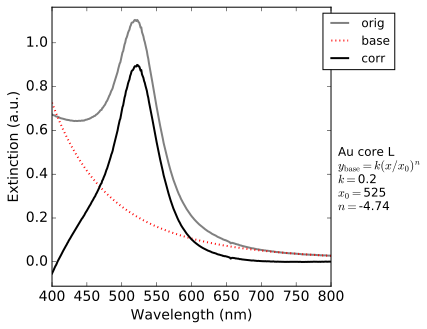

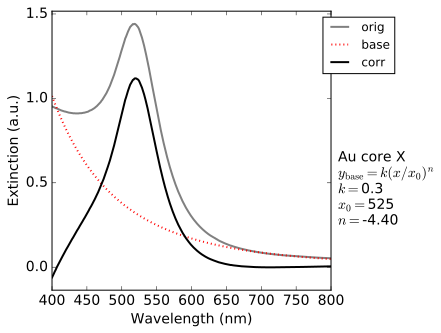

In [7]:
print('Core only spectra: baseline correction')
print('======================================')
print('Individually. Not used to assess LSPR wavelength,', 
      'but to correct core-shell spectra')
def plotAndSave (sampleNum):   
    sampleLabel = 'Au core '+['L','X'][sampleNum]
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []

    # data set 1
    label = 'orig'
    color = 'gray'
    marker = ''
    line = '-'
    plotArray = lsprPowrBaselineCoreList[sampleNum]
    x, y = plotArray[0], plotArray[1]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 2
    label = 'base'
    color = 'red'
    marker = ''
    line = ':'
    plotArray = lsprPowrBaselineCoreList[sampleNum]
    x, y = plotArray[0], plotArray[-1]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 3
    label = 'corr'
    color = 'black'
    marker = ''
    line = '-'
    plotArray = lsprPowrBaselineCoreList[sampleNum]
    x, y = plotArray[0], plotArray[-2]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.0*dx, np.amax(x)+ 0.0*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Wavelength (nm)')
    pylab.ylabel('Extinction (a.u.)')
    fitx0 = lsprPowrBaselineCorenkList[sampleNum][0]
    fitn = lsprPowrBaselineCorenkList[sampleNum][1]
    fitk = lsprPowrBaselineCorenkList[sampleNum][2]
    figText = (sampleLabel + '\n$y_{\mathrm{base}} = k(x/x_0)^n$'
               + '\n$k=${0:.1f}\n$x_0=${1}\n$n=${2:.2f}'.format(fitk,fitx0,fitn))
    pylab.text(xLimits[1]+0.025*dx, yLimits[0]+0.5*dy, figText, 
               verticalalignment='top', horizontalalignment='left')
    pylab.legend(loc='upper right', bbox_to_anchor=(1.25,1.), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=8)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_spectrum-core-baseline-powr_" + sampleLabel)
    filename = "graphics/" + timestamp + identifier + exportFormat
    #pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
for sampleNum in range(2):
    plotAndSave(sampleNum) 


### Core-shell without core correction (for comparison, no variables saved)

In [7]:
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 25
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier0 = "lspr-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'orig-wl-nm', 'temp-C', 'Rh-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Core-shell nanoparticles')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm,\t [wl-nm, ext, T-C, Rh-nm], \t (orig wl-nm)',
     '\t (n0, k0)', '\t scal.',  '\t (n, k)')

lsprPowrPeakWLnmList = []
lsprPowrBaselineList = []
lsprPowrBaselinenkList = []
lsprPowrBaselineExpvsScaPrmList = []
x = []
for sampleNum in range(6):
    sampleType = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
    print(' * Sample #',sampleNum,'(', sampleType, ')')
    lsprPeakWLnmSubList = []
    indexT = 0
    coreNum = 0
    if sampleNum >= 3: coreNum = 1
    
    for T in spectraTemps[sampleNum]:
        selection = ((dataArray[:,-1] == sampleNum) 
                     & (dataArray[:,-3] == T)
                     & (dataArray[:,0] >= wlMin0nm) 
                     & (dataArray[:,0] <= wlMax0nm)
                     )
        subdataArray = dataArray[selection]
        minDist = int(subdataArray.size/(nPeaks+1))
        
        x, y = subdataArray[:,0], subdataArray[:,1]
        yOrig = y
        logx, logy = np.log(x/x0base), np.log(y)
        dlogx = min(np.diff(logx))
        loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
        loglogy = np.interp(loglogx, logx, logy - min(logy))

        loglogyLinBase = peakutils.baseline(loglogy, 1)
        logyLinBase = np.interp(logx, loglogx, loglogyLinBase) + min(logy)
        loglogfit = np.polyfit(logx, logyLinBase, 1)
        basePowrn0, baseCoeffk0 = loglogfit[0], np.exp(loglogfit[1])
    
        yPowrBase = (np.exp(logyLinBase))
        y = y - yPowrBase
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = (anArray[selection][:,1]).tolist()
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + (wlMinnm - wlMin0nm)
        xPeaks = x[indexes]
        
        scaling = 1                
#         selection = ( (lsprPowrBaselineCoreList[coreNum][0] >= wlMin0nm)
#                      & (lsprPowrBaselineCoreList[coreNum][0] <= wlMax0nm)
#                      )
#         yCorePowrBase = np.asarray(lsprPowrBaselineCoreList[coreNum][-1])[selection]
#         yCorePeak = lsprPowrBaselineCoreList[coreNum][2]
#         scaling = 1*y[indexes][0]/yCorePeak
#         y = y + yCorePowrBase*scaling
        
#         # fit [(base) - (core base)] to power law
#         yPowrBaseTotal = yPowrBase - yCorePowrBase*scaling
#         logy = np.log(yPowrBaseTotal)
#         if min(yPowrBaseTotal) > 0: 
#             logy = np.log(yPowrBaseTotal)
#             loglogfit = np.polyfit(logx, logy, 1)
#         else: loglogfit = [0, 0]
#         basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])
        
#         indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
#         xPeaks = x[indexes]
#         anArray = (np.array([xPeaks, indexes])).T
#         selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
#         indexes = (anArray[selection][:,1]).tolist()
#         # if no peaks:
#         if (len(indexes) == 0): 
#             selection = (x >= wlMinnm) & (x <= wlMaxnm)
#             xzoom, yzoom = x[selection], y[selection]
#             indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
#             indexes = indexeszoom + (wlMinnm - wlMin0nm)
#         xPeaks = x[indexes]

#         # iterate 
#         for i in range(20):
#             oldScaling = scaling
#             scaling = 1*(y[indexes[0]] - yCorePowrBase[indexes[0]]*scaling)/yCorePeak
#             if ( abs(1-oldScaling/scaling) < 0.000001 ): break
            
#             y = yOrig - yPowrBase + yCorePowrBase*scaling
#             indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
#             xPeaks = x[indexes]
#             anArray = (np.array([xPeaks, indexes])).T
#             selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
#             indexes = (anArray[selection][:,1]).tolist()
#             # if no peaks:
#             if (len(indexes) == 0): 
#                 selection = (x >= wlMinnm) & (x <= wlMaxnm)
#                 xzoom, yzoom = x[selection], y[selection]
#                 indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
#                 indexes = indexeszoom + (wlMinnm - wlMin0nm)

        if (len(indexes) > 0): 
            result = subdataArray[indexes[0]]
            Rhnm = result[-2]
            xPeaks = peakutils.interpolate(x, y, indexes)
            selection = (lsprPeakWLnmArray[:,-1] == sampleNum) & (lsprPeakWLnmArray[:,-3] == T)
            xPeaksOrig = lsprPeakWLnmArray[selection]
            if len(xPeaksOrig) > 0: xPeaksOrig = xPeaksOrig[0, 0]
            else: xPeaksOrig = 0
            indexT = indexT + 1
            print('   ', round(100*xPeaks[0])/100,',\t',  
                  (np.round(100*result[0:-1])/100).tolist(),
                  '\t (',round(100*xPeaksOrig)/100,')',
                  '\t ({0:.2f}, {1:.3f})\t {2:.3f}'.format(basePowrn0, baseCoeffk0, scaling),
                  '\t ({0:.2f}, {1:.3f}) '.format(basePowrn, baseCoeffk))
            result = [xPeaks[0], xPeaksOrig, result[-3], result[-2], int(result[-1])]
#             lsprPowrPeakWLnmList.append(result)
#             lsprPowrBaselineList.append([x, yOrig, scaling, y, yPowrBase, 
#                                          yPowrBase-yCorePowrBase*scaling])
#             lsprPowrBaselinenkList.append([x0base, basePowrn0, baseCoeffk0])
            result = [xPeaks[0], xPeaksOrig, result[-3], result[-2]]
            lsprPeakWLnmSubList.append(result)
            
            scatParam = 2*pi*Rhnm/(xPeaks[0]/1.35)
#             lsprPowrBaselineExpvsScaPrmList.append([scatParam, basePowrn])
            
    if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
    lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)
    identifier = '_' + identifier0 + '_' + str(sampleNum) + '-' + sampleType
    filename = folder + timestamp + identifier + exportFormat
#     np.savetxt(filename, lsprPeakWLnmSubList, delimiter='\t', header=datHeader, fmt='%.2f')
#     print('      + saved to', filename) 

# lsprPowrPeakWLnmArray = np.asarray(lsprPowrPeakWLnmList)
# print('variable: \t lsprPolyPeakWLnmArray')
# print("  * output array format: \n    [ peak-wl-nm, orig-peak-wl-nm, temp-C, Rh-nm, sample-# ]")
# print("    - sample-# = [0,...,5] \n      for [lin-Thin, lin-Med., lin-Long, X-Thin, X-Med., X-Long]")
# print('variable: \t lsprPolyBaselineList')
# print("  * output array format: \n",
#       "   [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data,",
#       "baseline-correction-no-core-data, baseline-correction-data]")
# print('  * wavelength range: [',x[0],',',x[-1],'] x (',len(x), 'values)')
# print('variable: \t lsprPowrBaselinenkList')
# print("  * output array format: \n    [ x0, n0, k0 ]")
# print('variable: \t lsprPowrBaselineExpvsScaPrmList')
# print("  * output array format: \n    [ ScatParam, n-exponent ]")


LSPR peak wavelengths
Core-shell nanoparticles
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 525
  * looking for one peak at 525 nm 
    - in the range [ 500 , 550 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm,	 [wl-nm, ext, T-C, Rh-nm], 	 (orig wl-nm) 	 (n0, k0) 	 scal. 	 (n, k)
 * Sample # 0 ( L1-Thn )
    525.09 ,	 [526.0, 0.69, 15.0, 24.77] 	 ( 523.45 ) 	 (-4.79, 0.120)	 1.000 	 (-4.40, 0.306) 
    525.4 ,	 [526.0, 0.69, 20.0, 23.19] 	 ( 523.68 ) 	 (-4.69, 0.123)	 1.000 	 (-4.40, 0.306) 
    525.7 ,	 [526.0, 0.69, 25.0, 23.8] 	 ( 523.97 ) 	 (-4.68, 0.125)	 1.000 	 (-4.40, 0.306) 
    525.84 ,	 [527.0, 0.7, 27.0, 23.82] 	 ( 524.12 ) 	 (-4.63, 0.126)	 1.000 	 (-4.40, 0.306) 
    526.01 ,	 [527.0, 0.69, 29.0, 23.4] 	 ( 524.17 ) 	 (-4.80, 0.121)	 1.000 	 (-4.40, 0.306) 
    526.27 ,	 [525.0, 0.7, 31.0, 21.81] 	 ( 524.52 ) 	 (-4.63, 0.126)	 1.000 	 (-4.40, 0.306) 
    526.31 ,	 [525.0, 0.7,

### Core-shell

In [9]:
exportFlag = False
threshold = 0.25
wlExpectednm = 525
dwlExpectednm = 25
x0base = wlExpectednm
nPeaks = 1
wlMin0nm, wlMax0nm = 400, 800
wlMinnm, wlMaxnm = wlExpectednm-dwlExpectednm, wlExpectednm+dwlExpectednm

timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
exportFormat = '.dat'
identifier0 = "lspr-peaks_baseline-powr"
folder = 'graphics/'
datHeader = ('\t').join(('wl-nm', 'orig-wl-nm', 'temp-C', 'Rh-nm'))

print('LSPR peak wavelengths')
print('=====================')
print('Core-shell nanoparticles')
print('  * power law baseline fit')
print('    - of the form ybase = k*(x/x0)^n')
print('    - using log-log/linear fitting with x0 =',x0base)
print('  * looking for one peak at', wlExpectednm, 
      'nm \n    - in the range [', wlMinnm, ',', wlMaxnm, '] nm')
print('    - baseline correction range [', wlMin0nm, ',', wlMax0nm, '] nm')
print('Peaks detected: \n    wl-nm,\t [wl-nm, ext, T-C, Rh-nm], \t (orig wl-nm)',
     '\t (n0, k0)', '\t scal.',  '\t (n, k)')

lsprPowrPeakWLnmList = []
lsprPowrBaselineList = []
lsprPowrBaselinenkList = []
lsprPowrBaselineExpvsScaPrmList = []
x = []
for sampleNum in range(6):
    sampleType = (['L-Thn','L-Med','L-Thk','X-Thn','X-Med','X-Thk'][sampleNum])
    print(' * Sample #',sampleNum,'(', sampleType, ')')
    lsprPeakWLnmSubList = []
    indexT = 0
    coreNum = 0
    if sampleNum >= 3: coreNum = 1
    
    for T in spectraTemps[sampleNum]:
        selection = ((dataArray[:,-1] == sampleNum) 
                     & (dataArray[:,-3] == T)
                     & (dataArray[:,0] >= wlMin0nm) 
                     & (dataArray[:,0] <= wlMax0nm)
                     )
        subdataArray = dataArray[selection]
        minDist = int(subdataArray.size/(nPeaks+1))
        
        x, y = subdataArray[:,0], subdataArray[:,1]
        yOrig = y
        logx, logy = np.log(x/x0base), np.log(y)
        dlogx = min(np.diff(logx))
        loglogx = np.arange(min(logx), max(logx) + dlogx, dlogx)
        loglogy = np.interp(loglogx, logx, logy - min(logy))

        loglogyLinBase = peakutils.baseline(loglogy, 1)
        logyLinBase = np.interp(logx, loglogx, loglogyLinBase) + min(logy)
        loglogfit = np.polyfit(logx, logyLinBase, 1)
        basePowrn0, baseCoeffk0 = loglogfit[0], np.exp(loglogfit[1])
    
        yPowrBase = (np.exp(logyLinBase))
        y = y - yPowrBase
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = (anArray[selection][:,1]).tolist()
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + (wlMinnm - wlMin0nm)
        xPeaks = x[indexes]
                
        selection = ( (lsprPowrBaselineCoreList[coreNum][0] >= wlMin0nm)
                     & (lsprPowrBaselineCoreList[coreNum][0] <= wlMax0nm)
                     )
        yCorePowrBase = np.asarray(lsprPowrBaselineCoreList[coreNum][-1])[selection]
        yCorePeak = lsprPowrBaselineCoreList[coreNum][2]
        scaling = 1*y[indexes][0]/yCorePeak
        y = y + yCorePowrBase*scaling
        
        # fit [(base) - (core base)] to power law
        yPowrBaseTotal = yPowrBase - yCorePowrBase*scaling
        logy = np.log(yPowrBaseTotal)
        if min(yPowrBaseTotal) > 0: 
            logy = np.log(yPowrBaseTotal)
            loglogfit = np.polyfit(logx, logy, 1)
        else: loglogfit = [0, 0]
        basePowrn, baseCoeffk = loglogfit[0], np.exp(loglogfit[1])
        
        indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
        xPeaks = x[indexes]
        anArray = (np.array([xPeaks, indexes])).T
        selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
        indexes = (anArray[selection][:,1]).tolist()
        # if no peaks:
        if (len(indexes) == 0): 
            selection = (x >= wlMinnm) & (x <= wlMaxnm)
            xzoom, yzoom = x[selection], y[selection]
            indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
            indexes = indexeszoom + (wlMinnm - wlMin0nm)
        xPeaks = x[indexes]

        # iterate 
        for i in range(20):
            oldScaling = scaling
            scaling = 1*(y[indexes[0]] - yCorePowrBase[indexes[0]]*scaling)/yCorePeak
            if ( abs(1-oldScaling/scaling) < 0.000001 ): break
            
            y = yOrig - yPowrBase + yCorePowrBase*scaling
            indexes = peakutils.indexes(y, thres=threshold, min_dist=minDist)
            xPeaks = x[indexes]
            anArray = (np.array([xPeaks, indexes])).T
            selection = (anArray[:,0] > wlMinnm) & (anArray[:,0] < wlMaxnm)
            indexes = (anArray[selection][:,1]).tolist()
            # if no peaks:
            if (len(indexes) == 0): 
                selection = (x >= wlMinnm) & (x <= wlMaxnm)
                xzoom, yzoom = x[selection], y[selection]
                indexeszoom = peakutils.indexes(yzoom, thres=threshold, min_dist=minDist)
                indexes = indexeszoom + (wlMinnm - wlMin0nm)

        if (len(indexes) > 0): 
            result = subdataArray[indexes[0]]
            Rhnm = result[-2]
            xPeaks = peakutils.interpolate(x, y, indexes)
            selection = (lsprPeakWLnmArray[:,-1] == sampleNum) & (lsprPeakWLnmArray[:,-3] == T)
            xPeaksOrig = lsprPeakWLnmArray[selection]
            if len(xPeaksOrig) > 0: xPeaksOrig = xPeaksOrig[0, 0]
            else: xPeaksOrig = 0
            indexT = indexT + 1
            print('   ', round(100*xPeaks[0])/100,',\t',  
                  (np.round(100*result[0:-1])/100).tolist(),
                  '\t (',round(100*xPeaksOrig)/100,')',
                  '\t ({0:.2f}, {1:.3f})\t {2:.3f}'.format(basePowrn0, baseCoeffk0, scaling),
                  '\t ({0:.2f}, {1:.3f}) '.format(basePowrn, baseCoeffk))
            result = [xPeaks[0], xPeaksOrig, result[-3], result[-2], int(result[-1])]
            lsprPowrPeakWLnmList.append(result)
            lsprPowrBaselineList.append([x, yOrig, scaling, y, yPowrBase, 
                                         yPowrBase-yCorePowrBase*scaling])
            lsprPowrBaselinenkList.append([x0base, basePowrn0, baseCoeffk0])
            result = [xPeaks[0], xPeaksOrig, result[-3], result[-2]]
            lsprPeakWLnmSubList.append(result)
            
            scatParam = 2*pi*Rhnm/(xPeaks[0]/1.35)
            lsprPowrBaselineExpvsScaPrmList.append([scatParam, basePowrn])
            
    if len(lsprPeakWLnmSubList) == 0: lsprPeakWLnmSubList.append( [0,0,0] )
    lsprPeakWLnmSubList = np.asarray(lsprPeakWLnmSubList)
    identifier = '_' + identifier0 + '_' + str(sampleNum) + '-' + sampleType
    filename = folder + timestamp + identifier + exportFormat
    if (exportFlag):
        np.savetxt(filename, lsprPeakWLnmSubList, delimiter='\t', header=datHeader, fmt='%.2f')
        print('      + saved to', filename) 

lsprPowrPeakWLnmArray = np.asarray(lsprPowrPeakWLnmList)
print('variable: \t lsprPolyPeakWLnmArray')
print("  * output array format: \n    [ peak-wl-nm, orig-peak-wl-nm, temp-C, Rh-nm, sample-# ]")
print("    - sample-# = [0,...,5] \n      for [lin-Thin, lin-Med., lin-Long, X-Thin, X-Med., X-Long]")
print('variable: \t lsprPolyBaselineList')
print("  * output array format: \n",
      "   [ wl-nm-data, ext-orig-data, ext-scaling-factor, ext-corrected-data,",
      "baseline-correction-no-core-data, baseline-correction-data]")
print('  * wavelength range: [',x[0],',',x[-1],'] x (',len(x), 'values)')
print('variable: \t lsprPowrBaselinenkList')
print("  * output array format: \n    [ x0, n0, k0 ]")
print('variable: \t lsprPowrBaselineExpvsScaPrmList')
print("  * output array format: \n    [ ScatParam, n-exponent ]")


LSPR peak wavelengths
Core-shell nanoparticles
  * power law baseline fit
    - of the form ybase = k*(x/x0)^n
    - using log-log/linear fitting with x0 = 525
  * looking for one peak at 525 nm 
    - in the range [ 500 , 550 ] nm
    - baseline correction range [ 400 , 800 ] nm
Peaks detected: 
    wl-nm,	 [wl-nm, ext, T-C, Rh-nm], 	 (orig wl-nm) 	 (n0, k0) 	 scal. 	 (n, k)
 * Sample # 0 ( L-Thn )
    523.33 ,	 [522.0, 0.69, 15.0, 24.77] 	 ( 523.45 ) 	 (-4.79, 0.120)	 0.629 	 (0.00, 1.000) 
    523.62 ,	 [524.0, 0.69, 20.0, 23.19] 	 ( 523.68 ) 	 (-4.69, 0.123)	 0.629 	 (0.00, 1.000) 
    523.91 ,	 [526.0, 0.69, 25.0, 23.8] 	 ( 523.97 ) 	 (-4.68, 0.125)	 0.635 	 (0.00, 1.000) 
    524.18 ,	 [523.0, 0.7, 27.0, 23.82] 	 ( 524.12 ) 	 (-4.63, 0.126)	 0.630 	 (0.00, 1.000) 
    524.1 ,	 [524.0, 0.7, 29.0, 23.4] 	 ( 524.17 ) 	 (-4.80, 0.121)	 0.638 	 (0.00, 1.000) 
    524.46 ,	 [524.0, 0.7, 31.0, 21.81] 	 ( 524.52 ) 	 (-4.63, 0.126)	 0.637 	 (0.00, 1.000) 
    524.47 ,	 [525.0, 0.7, 33.0, 

header_import_data.py:87: RuntimeWarning: invalid value encountered in log
  print("X-linked PNIPAM: ")


 523.7 ,	 [524.0, 0.63, 13.81, 79.79] 	 ( 522.6 ) 	 (-3.81, 0.201)	 0.380 	 (-3.06, 0.083) 
    523.86 ,	 [524.0, 0.63, 17.66, 78.12] 	 ( 522.73 ) 	 (-3.80, 0.204)	 0.380 	 (-3.05, 0.085) 
    524.0 ,	 [524.0, 0.63, 21.51, 75.96] 	 ( 522.83 ) 	 (-3.78, 0.206)	 0.380 	 (-3.05, 0.088) 
    524.25 ,	 [524.0, 0.63, 25.36, 71.31] 	 ( 523.18 ) 	 (-4.00, 0.192)	 0.386 	 (-3.40, 0.072) 
    524.39 ,	 [524.0, 0.63, 27.67, 70.38] 	 ( 523.28 ) 	 (-4.00, 0.194)	 0.387 	 (-3.41, 0.074) 
    524.41 ,	 [525.0, 0.63, 28.44, 70.38] 	 ( 523.3 ) 	 (-4.00, 0.195)	 0.389 	 (-3.41, 0.076) 
    524.53 ,	 [524.0, 0.63, 29.21, 70.38] 	 ( 523.38 ) 	 (-4.00, 0.197)	 0.388 	 (-3.42, 0.077) 
    524.58 ,	 [525.0, 0.63, 29.98, 68.96] 	 ( 523.43 ) 	 (-3.99, 0.198)	 0.389 	 (-3.42, 0.078) 
    524.63 ,	 [524.0, 0.64, 30.75, 68.96] 	 ( 523.45 ) 	 (-3.99, 0.199)	 0.389 	 (-3.42, 0.079) 
    524.71 ,	 [525.0, 0.64, 31.52, 67.86] 	 ( 523.53 ) 	 (-4.00, 0.200)	 0.390 	 (-3.43, 0.080) 
    524.76 ,	 [526.0, 0.64, 32.29, 66

### Baseline correction plots: core-shell only

Core-shell only spectra: baseline correction
Individually. 
  * "orig/Shl" = original core-shell NP spectrum
  * "base/Shl" = partial baseline correction (without core subtraction)
  * "base/Tot" = total baseline correction (with core substraction)
  * "corr/Shl" = corrected core-shell NP spectrum
  * "scld/Cor" = core-only NP spectrum scaled to match core-shell ext. peak


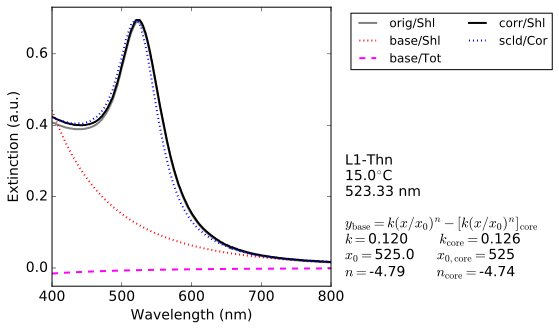

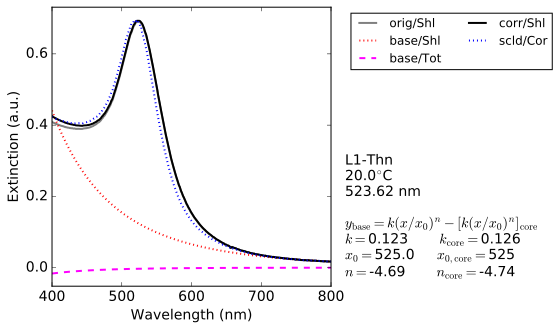

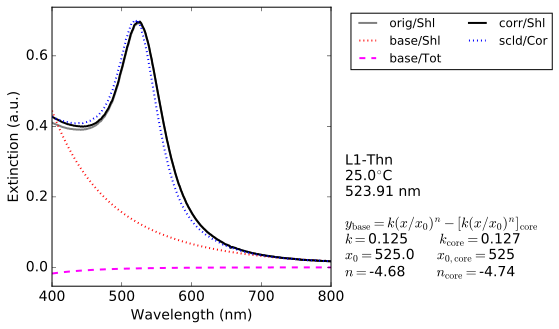

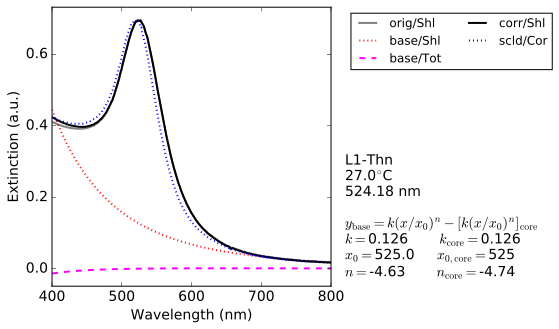

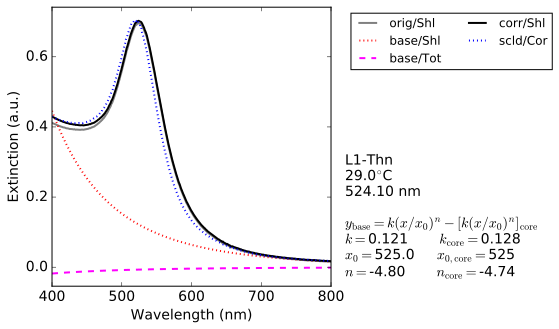

...

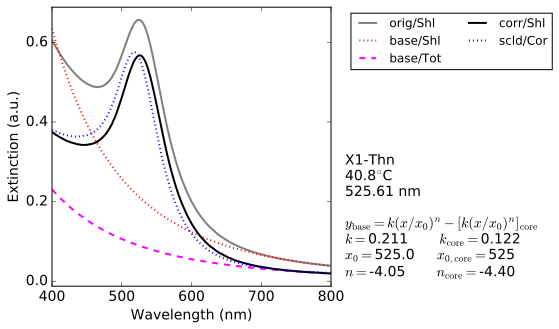

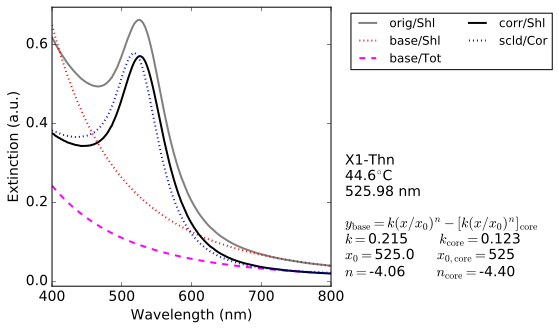

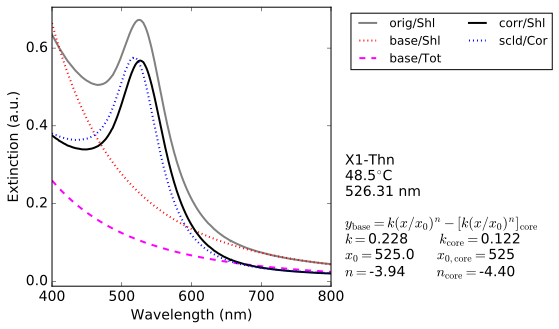

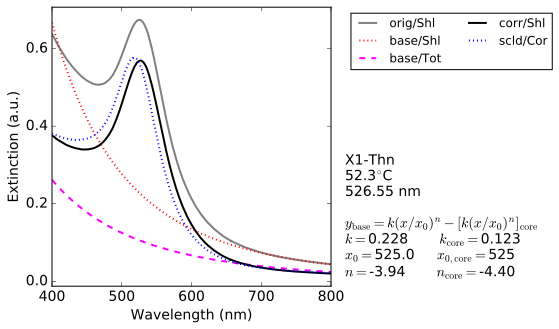

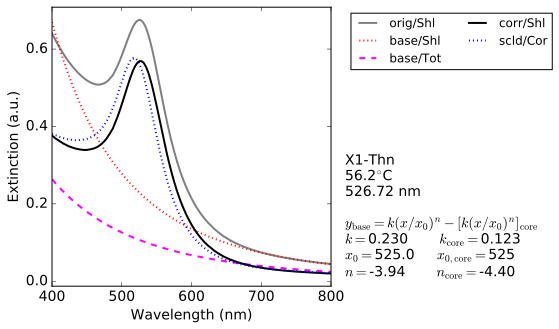

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-7.6.svg


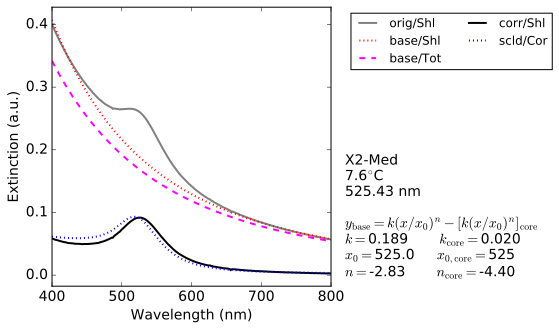

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-10.0.svg


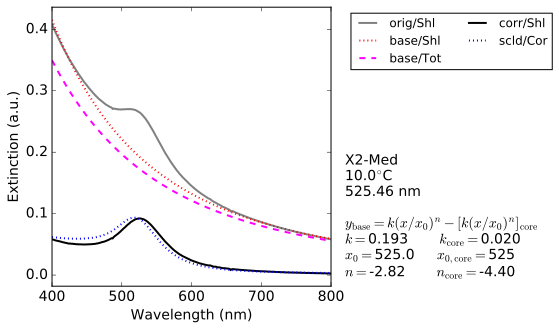

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-13.8.svg


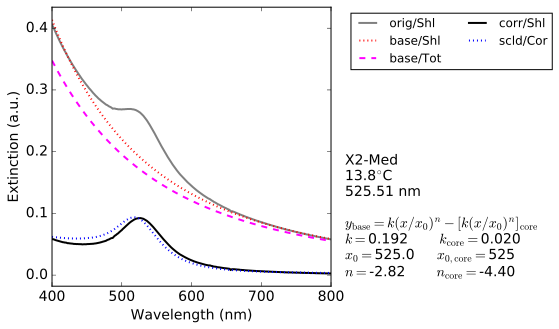

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-17.7.svg


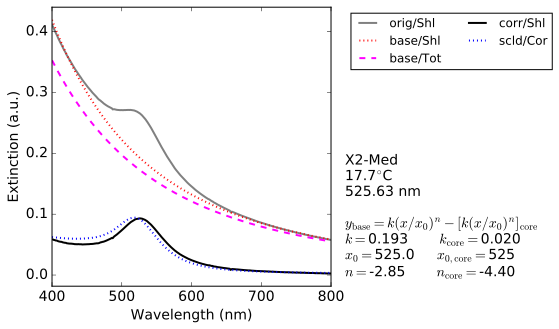

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-21.5.svg


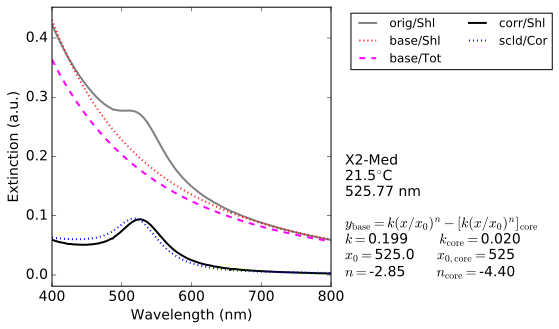

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-25.4.svg


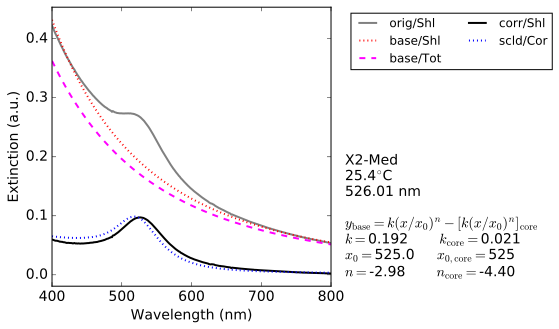

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-27.7.svg


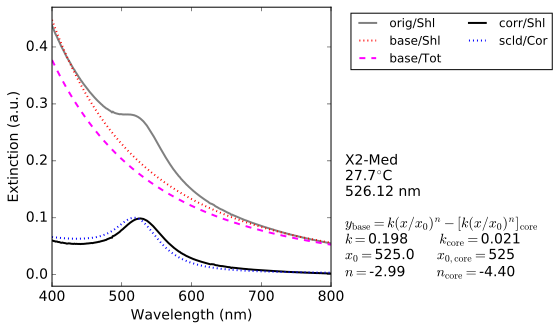

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-28.4.svg


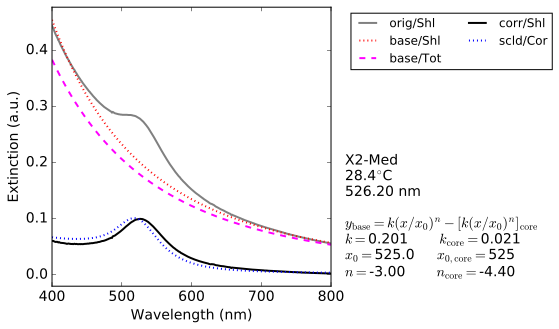

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-29.2.svg


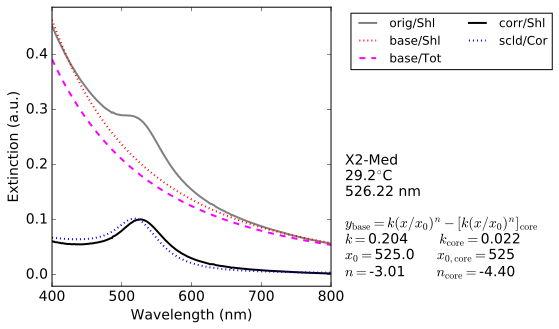

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-30.0.svg


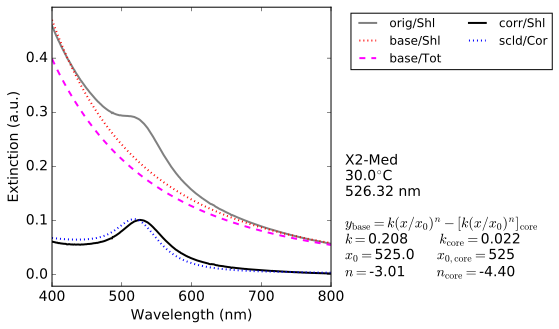

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-30.8.svg


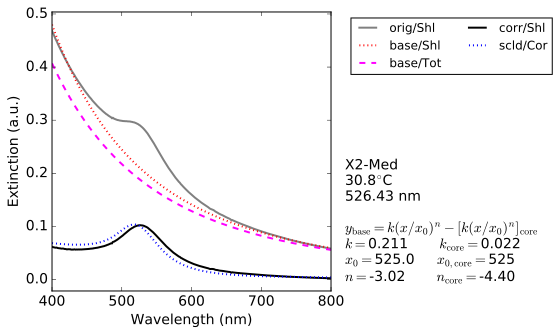

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-31.5.svg


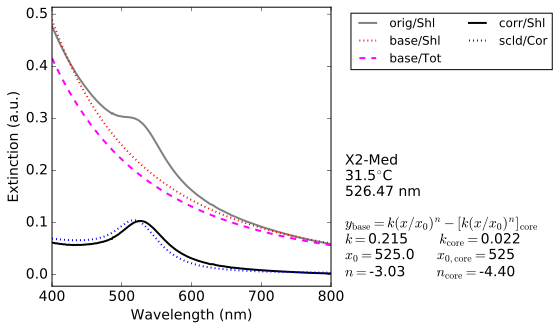

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-32.3.svg


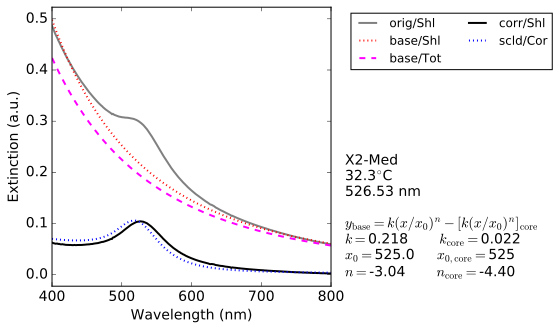

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-33.1.svg


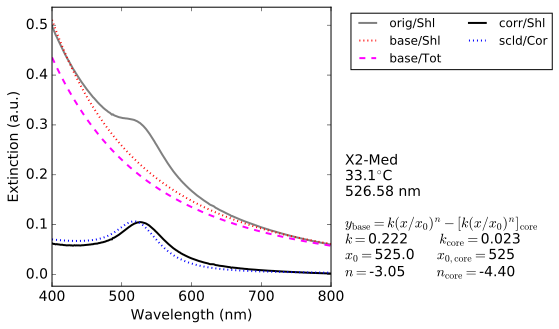

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-33.8.svg


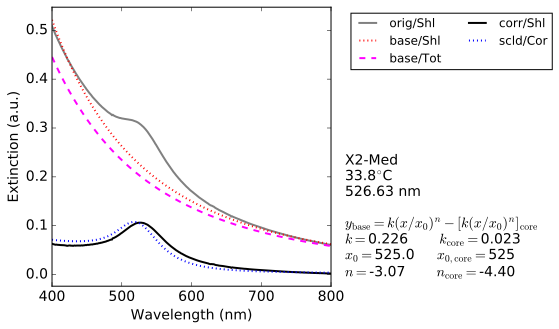

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-36.9.svg


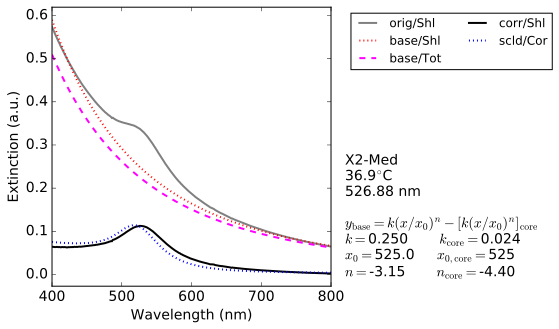

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-40.8.svg


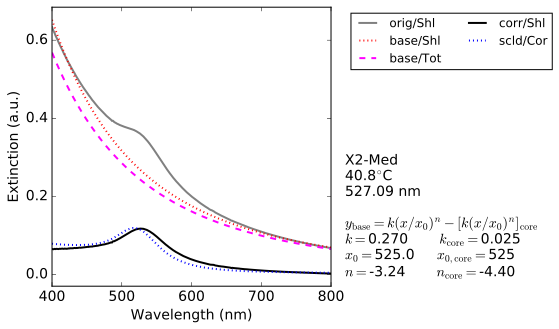

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-44.6.svg


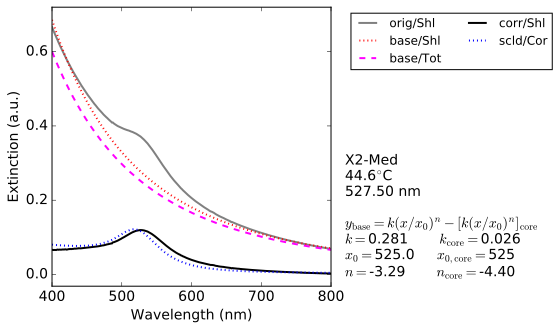

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-48.5.svg


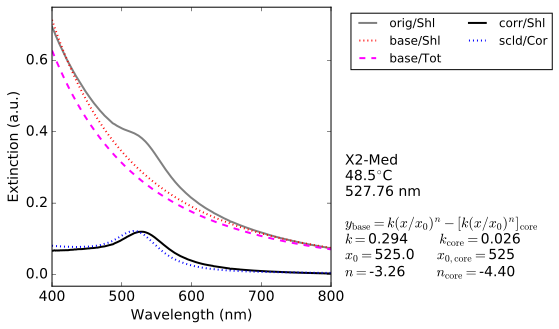

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-52.3.svg


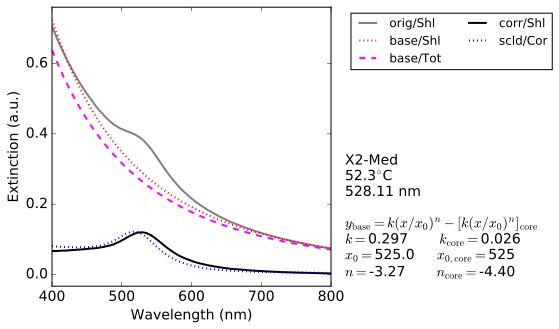

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_X2-Med-56.2.svg


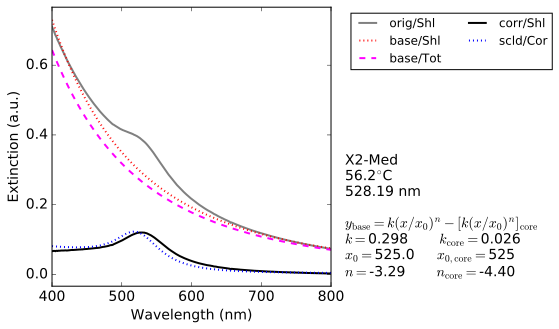

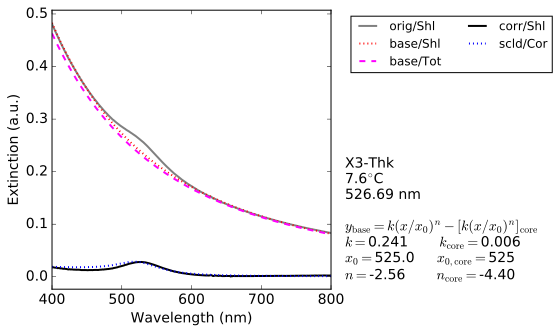

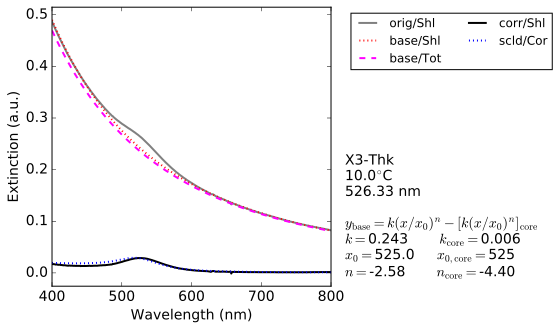

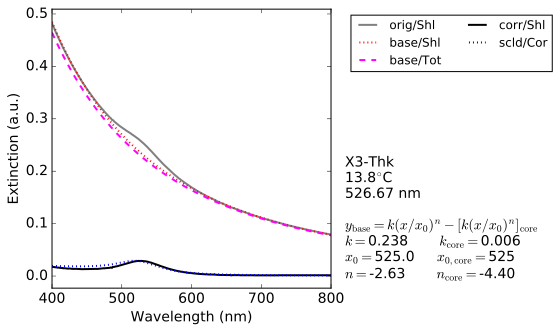

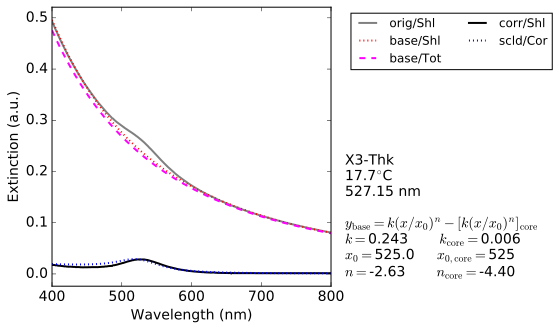

...

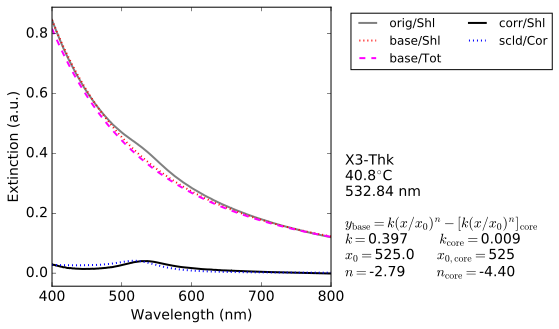

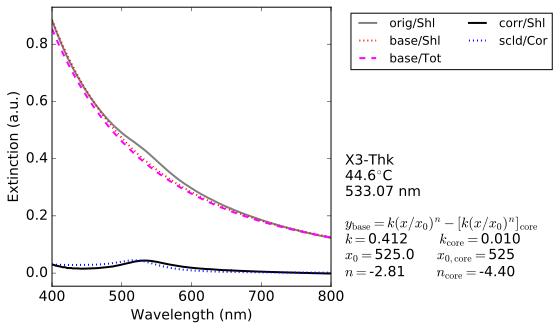

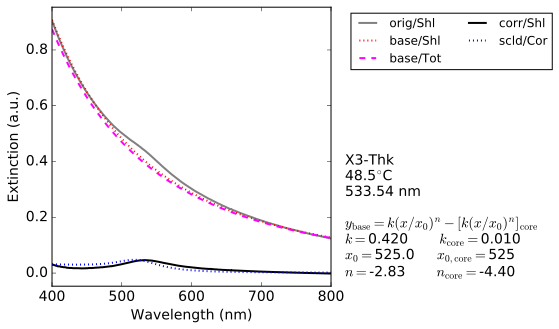

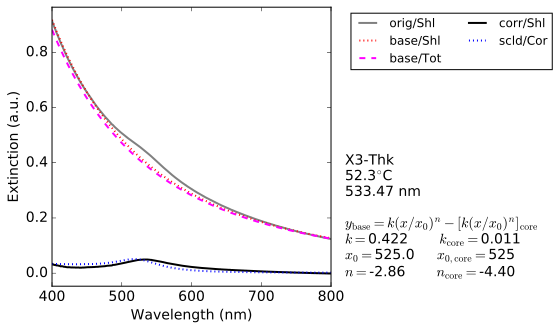

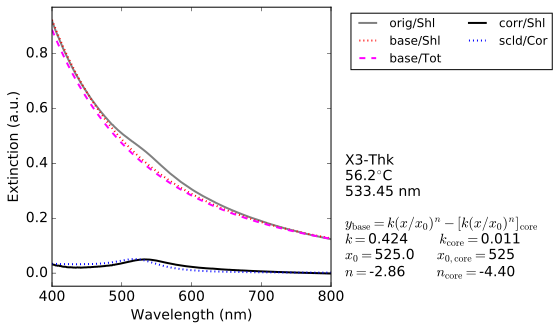

In [9]:
print('Core-shell only spectra: baseline correction')
print('======================================')
print('Individually. ')
print('  * \"orig/Shl\" = original core-shell NP spectrum')
print('  * \"base/Shl\" = partial baseline correction (without core subtraction)')
print('  * \"base/Tot\" = total baseline correction (with core substraction)')
print('  * \"corr/Shl\" = corrected core-shell NP spectrum')
print('  * \"scld/Cor\" = core-only NP spectrum scaled to match core-shell ext. peak')

def plotAndSave (sampleNum, tempC):   
    sampleLabel = ['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]
    tempLabel = str(round(10*tempC)/10)
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    coreNum = 0
    if (sampleNum >= 3): coreNum = 1
    
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum) & (lsprPowrPeakWLnmArray[:,-3] == tempC)
    plotArray = np.asarray(lsprPowrBaselineList)[selection][0]
    scaling = np.asarray(lsprPowrBaselineList)[selection][0,2]
    peakwlnm = lsprPowrPeakWLnmArray[selection][0,0]

    # data set 1
    label = 'orig/Shl'
    color = 'gray'
    marker = ''
    line = '-'
    x, y = plotArray[0], plotArray[1]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 2
    label = 'base/Shl'
    color = 'red'
    marker = ''
    line = ':'
    x, y = plotArray[0], plotArray[-2]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 3
    label = 'base/Tot'
    color = 'magenta'
    marker = ''
    line = '--'
    x, y = plotArray[0], plotArray[-1]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 4
    label = 'corr/Shl'
    color = 'black'
    marker = ''
    line = '-'
    x, y = plotArray[0], plotArray[-3]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)

    # data set 5
    label = 'scld/Cor'
    color = 'blue'
    marker = ''
    line = ':'
    plotArray = lsprPowrBaselineCoreList[coreNum]
    x, y = plotArray[0], plotArray[1]*scaling
    if scaling > 0:
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)

    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.0*dx, np.amax(x)+ 0.0*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Wavelength (nm)')
    pylab.ylabel('Extinction (a.u.)')
    fitx0 = np.asarray(lsprPowrBaselinenkList)[selection][0,0]
    fitn = np.asarray(lsprPowrBaselinenkList)[selection][0,1]
    fitk = np.asarray(lsprPowrBaselinenkList)[selection][0,2]
    fitCorex0 = lsprPowrBaselineCorenkList[coreNum][0]
    fitCoren = lsprPowrBaselineCorenkList[coreNum][1]
    fitCorek = scaling*lsprPowrBaselineCorenkList[coreNum][2]
    fitText = ('\n$y_{\mathrm{base}} = k(x/x_0)^n - [k(x/x_0)^n]_{\mathrm{core}}$'
               + '\n$k=${0:.3f}  '.format(fitk) 
               + '\t$k_{\mathrm{core}}=$' + '{0:.3f}'.format(fitCorek)
               + '\n$x_0=${0}'.format(fitx0)
               + '\t$x_{0,\mathrm{core}}=$' + '{0}'.format(fitCorex0)
               + '\n$n=${0:.2f}'.format(fitn) 
               + '\t$n_{\mathrm{core}}=' + '${0:.2f}'.format(fitCoren) )
    figText = (sampleLabel + '\n' + tempLabel + '$^{\circ}$C' + '\n{0:.2f} nm'.format(peakwlnm) + '\n')
    pylab.text(xLimits[1]+0.05*dx, yLimits[0]+0.025*dy, figText + fitText, 
               verticalalignment='bottom', horizontalalignment='left')
    pylab.legend(loc='upper left', bbox_to_anchor=(1.05,1), fontsize=12, ncol=2)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_spectrum-baseline-powr-corr_" + sampleLabel + '-' + tempLabel)
    filename = "graphics/" + timestamp + identifier + exportFormat
    if sampleNum == 4: pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
for sampleNum in range(6):
    for T in spectraTemps[sampleNum]:
        plotAndSave(sampleNum, T)


### Baseline correction plots: core-shell only, zoom

Core-shell only spectra: baseline correction
Individually. 
  * "corr/Shl" = corrected core-shell NP spectrum
  * "scld/Cor" = core-only NP spectrum scaled to match core-shell ext. peak


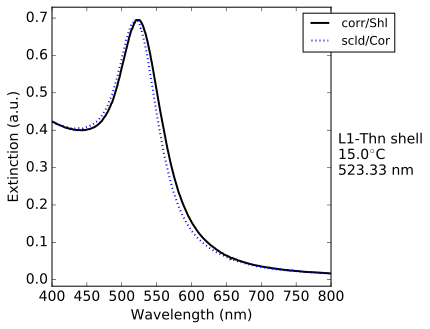

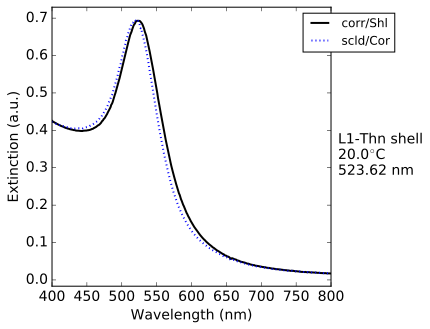

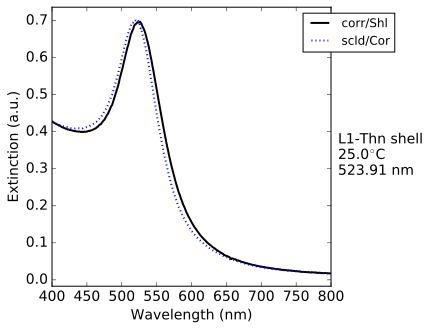

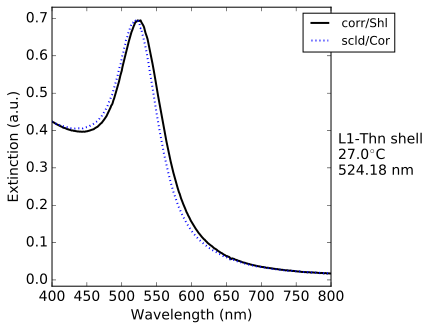

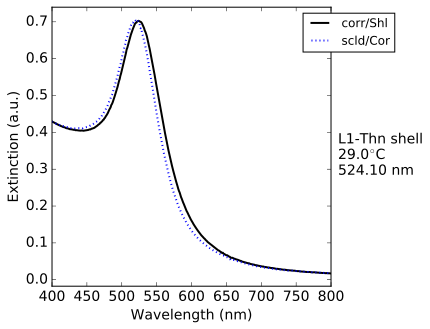

...

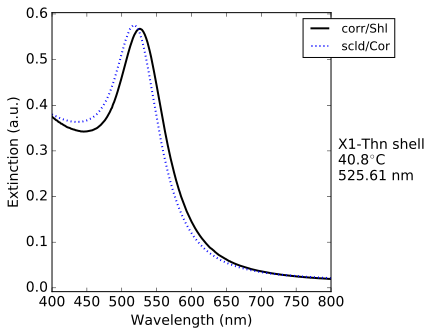

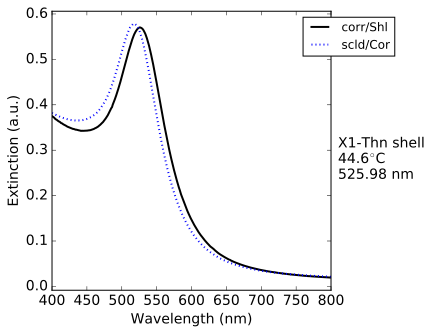

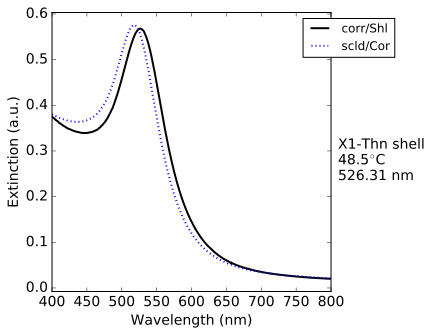

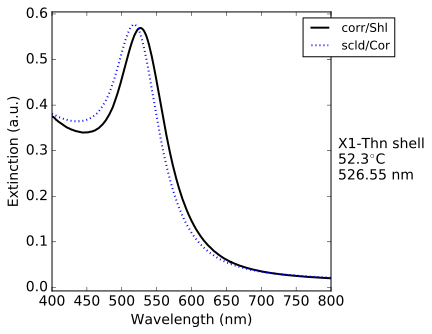

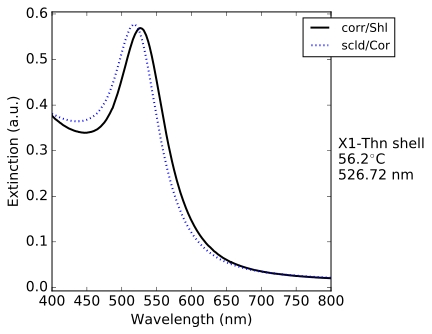

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-7.6.svg


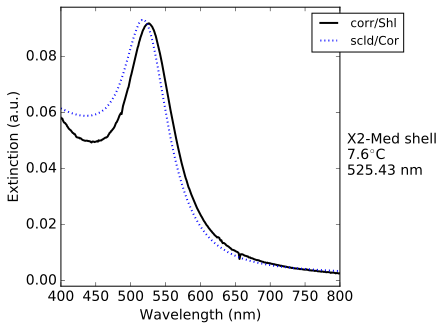

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-10.0.svg


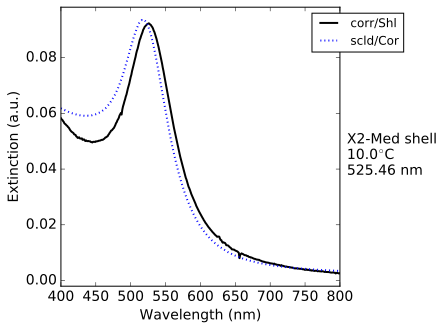

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-13.8.svg


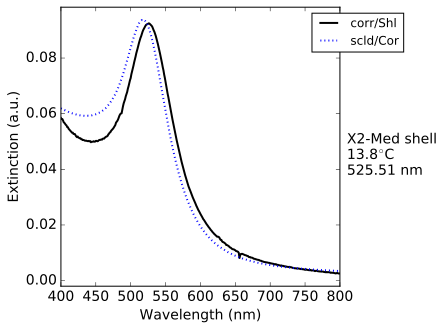

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-17.7.svg


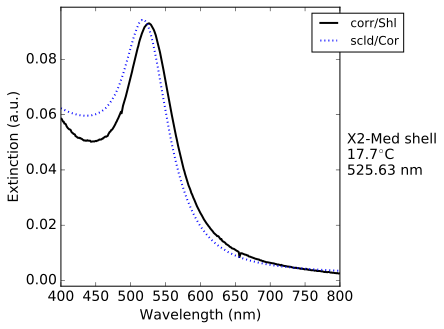

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-21.5.svg


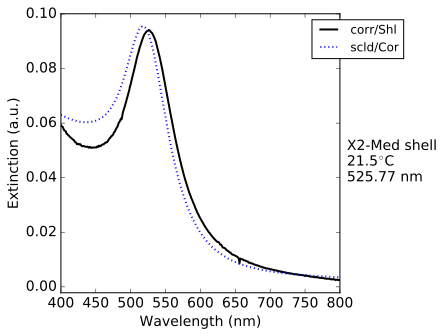

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-25.4.svg


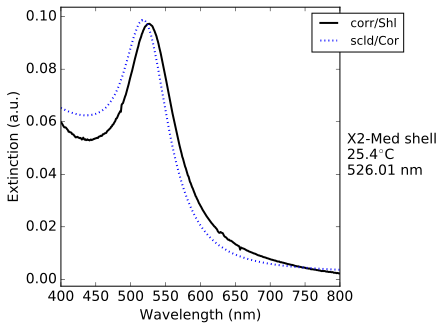

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-27.7.svg


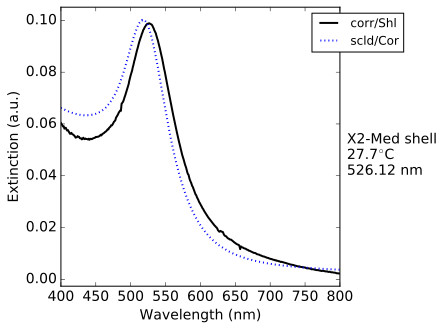

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-28.4.svg


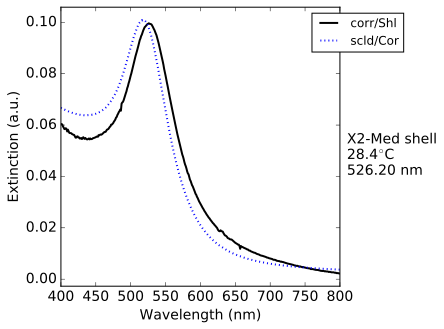

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-29.2.svg


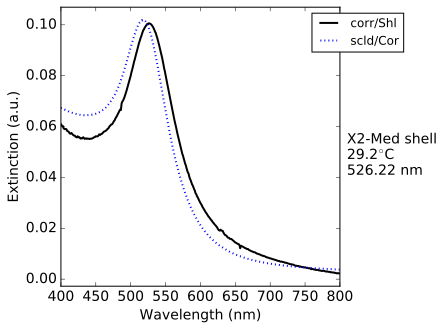

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-30.0.svg


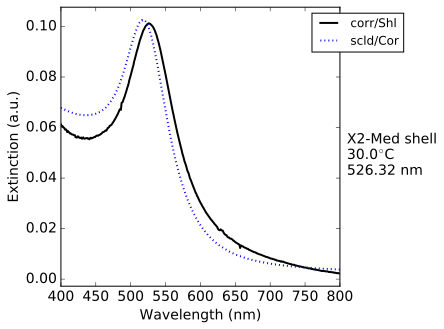

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-30.8.svg


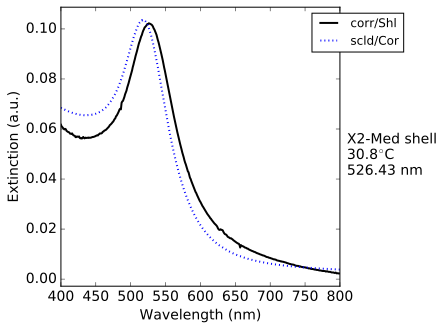

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-31.5.svg


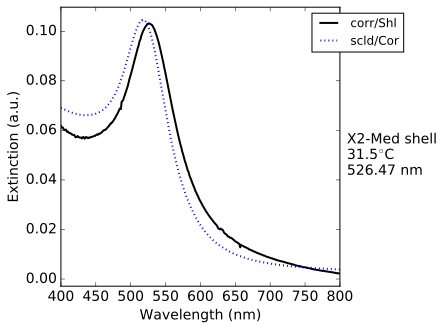

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-32.3.svg


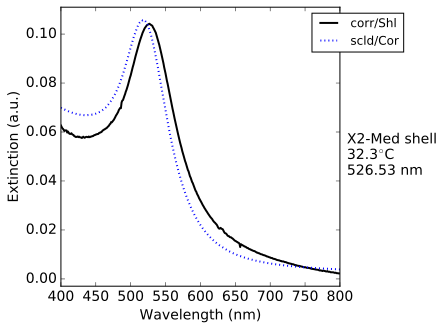

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-33.1.svg


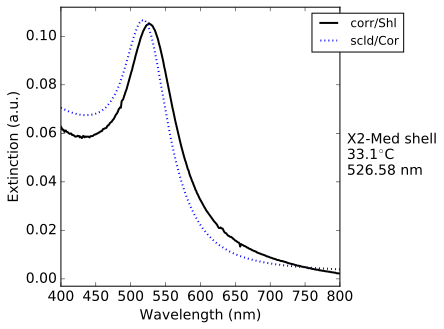

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-33.8.svg


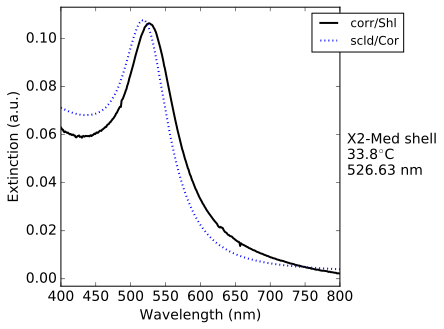

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-36.9.svg


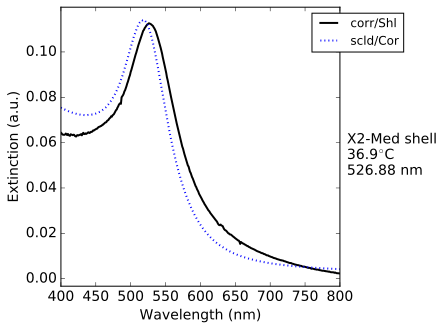

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-40.8.svg


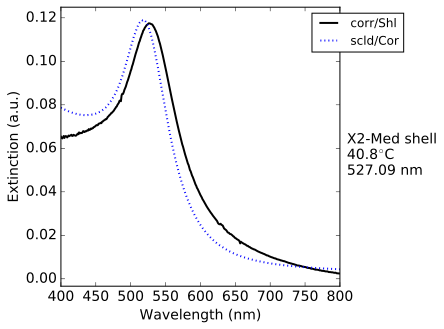

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-44.6.svg


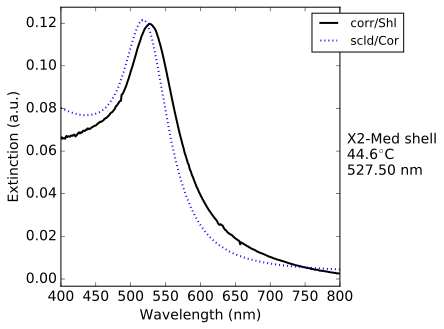

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-48.5.svg


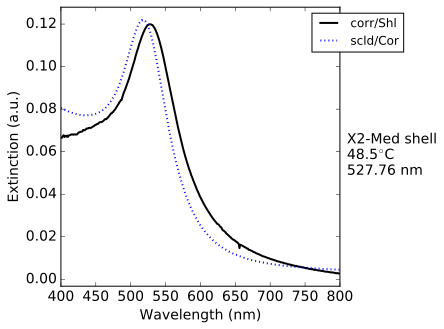

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-52.3.svg


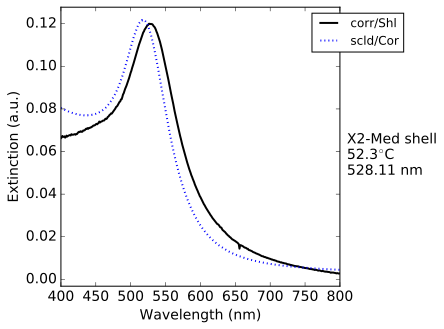

Exported to:
 graphics/20170321_spectrum-baseline-powr-corr_zoom-core-subtr__X2-Med shell-56.2.svg


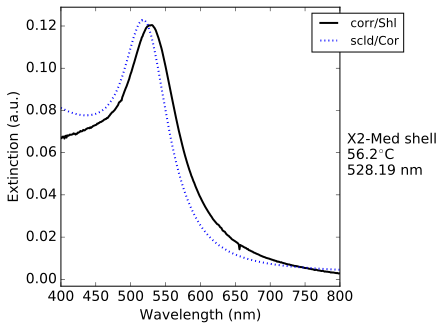

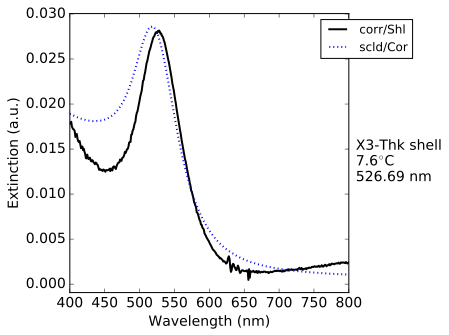

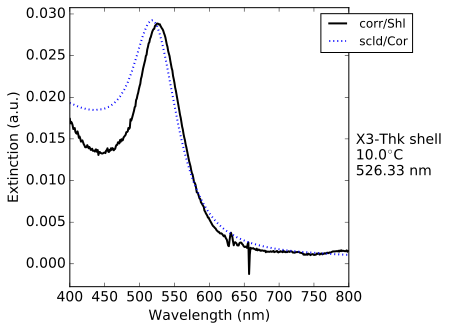

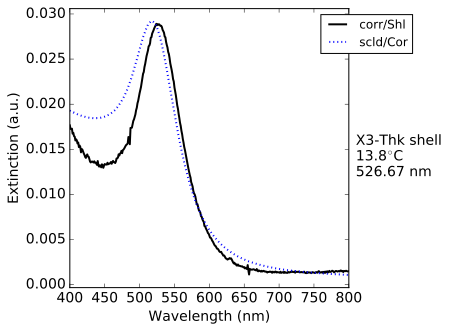

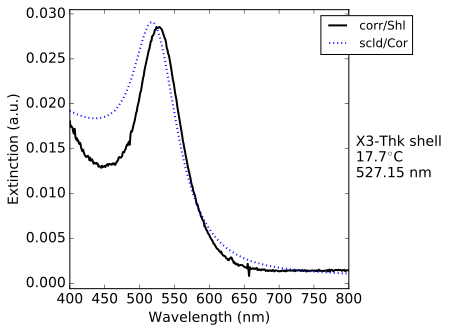

...

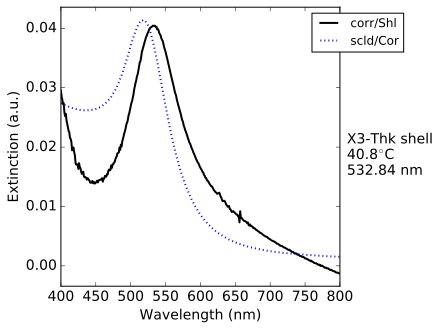

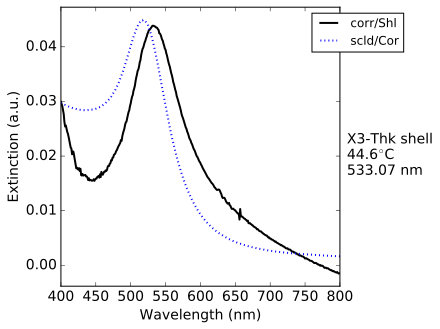

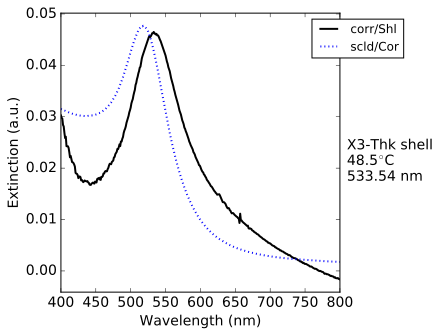

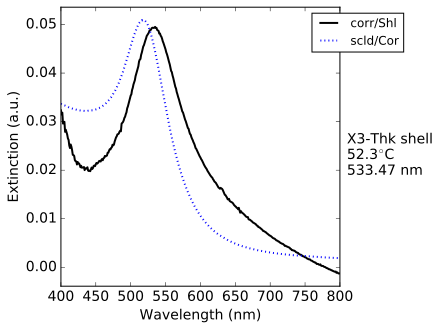

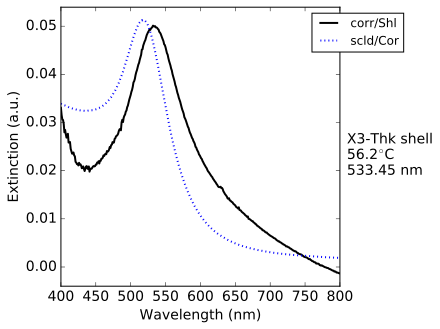

In [10]:
print('Core-shell only spectra: baseline correction')
print('======================================')
print('Individually. ')
print('  * \"corr/Shl\" = corrected core-shell NP spectrum')
print('  * \"scld/Cor\" = core-only NP spectrum scaled to match core-shell ext. peak')

def plotAndSave (sampleNum, tempC):   
    sampleLabel = ['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]+' shell'
    tempLabel = str(round(10*tempC)/10)
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    coreNum = 0
    if (sampleNum >= 3): coreNum = 1
    
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum) & (lsprPowrPeakWLnmArray[:,-3] == tempC)
    plotArray = np.asarray(lsprPowrBaselineList)[selection][0]
    scaling = np.asarray(lsprPowrBaselineList)[selection][0,2]
    peakwlnm = lsprPowrPeakWLnmArray[selection][0,0]
    
    # data set 4
    label = 'corr/Shl'
    color = 'black'
    marker = ''
    line = '-'
    x, y = plotArray[0], plotArray[-3]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)

    # data set 5
    label = 'scld/Cor'
    color = 'blue'
    marker = ''
    line = ':'
    plotArray = lsprPowrBaselineCoreList[coreNum]
    x, y = plotArray[0], plotArray[1]*scaling
    if scaling > 0 :
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)

    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.0*dx, np.amax(x)+ 0.0*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Wavelength (nm)')
    pylab.ylabel('Extinction (a.u.)')
    figText = (sampleLabel + '\n' + tempLabel + '$^{\circ}$C' + '\n{0:.2f} nm'.format(peakwlnm))
    pylab.text(xLimits[1]+0.025*dx, yLimits[0]+0.55*dy, figText, 
               verticalalignment='top', horizontalalignment='left')
    pylab.legend(loc='upper right', bbox_to_anchor=(1.25,1), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=8)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_spectrum-baseline-powr-corr_zoom-core-subtr_" + '_' + sampleLabel + '-' + tempLabel)
    filename = "graphics/" + timestamp + identifier + exportFormat
    if sampleNum == 4: pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
for sampleNum in range(6):
    for T in spectraTemps[sampleNum]:
        plotAndSave(sampleNum, T)


## Peak wavelength vs temperature plots

### Together with cores

All samples: peak LSPR wavelength vs temperature
Power law baseline corrected for scattering
Together with Au cores in black/gray for reference


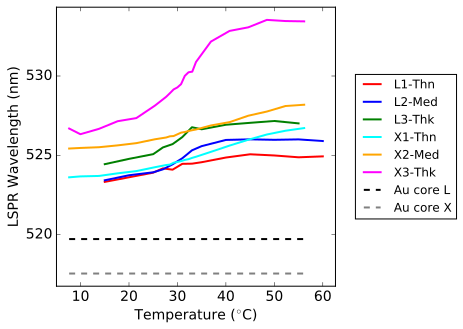

In [76]:
exportFlag = False
print('All samples: peak LSPR wavelength vs temperature')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together with Au cores in black/gray for reference')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = ['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-3], plotArray[:,0]
        if (x.size > 0) & (max(y) > 0):
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = ''
        line = '--'
        plotArray = lsprPeakWLnmCoreList[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(T); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Temperature ($^{\circ}$C)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-T_powr-corr_all" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores

All samples: peak LSPR wavelength vs temperature
Power law baseline corrected for scattering
Together without Au cores


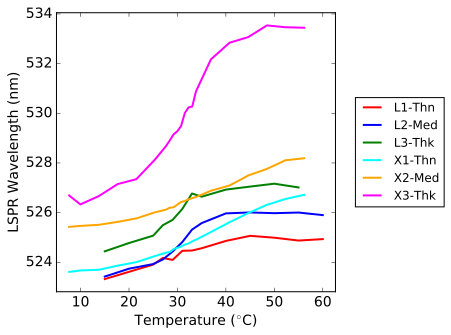

In [77]:
exportFlag = False
print('All samples: peak LSPR wavelength vs temperature')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together without Au cores')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-3], plotArray[:,0]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Temperature ($^{\circ}$C)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-T_powr-corr_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if(exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores, compared to no correction

All samples: peak LSPR wavelength vs temperature
Power law baseline corrected for scattering
Together without Au cores


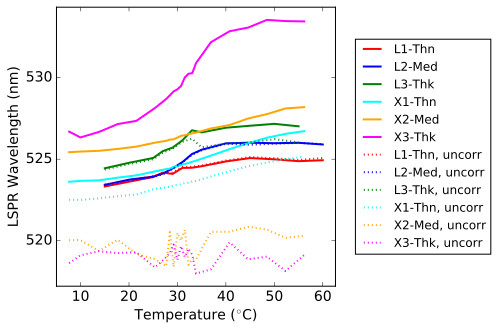

In [78]:
exportFlag = False
print('All samples: peak LSPR wavelength vs temperature')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together without Au cores')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-3], plotArray[:,0]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]) + ', uncorr'
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = ':'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-3], plotArray[:,1]
        if max(y) > 0: 
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Temperature ($^{\circ}$C)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-T_powr-corr+uncorr_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

## Peak wavelength vs hydrodynamic radius $R_h$ plots

### individually with cores

All samples: peak LSPR wavelength vs  hydrodynamic radius
Power law baseline corrected for scattering
Individually with Au core in red for reference


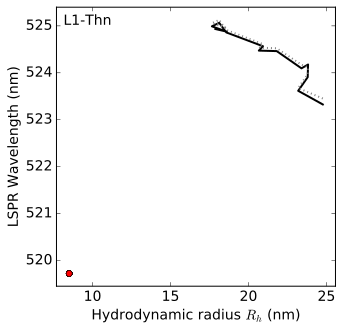

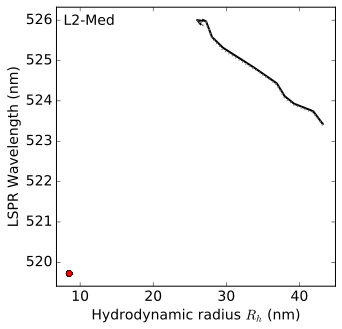

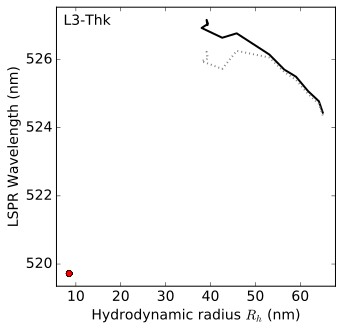

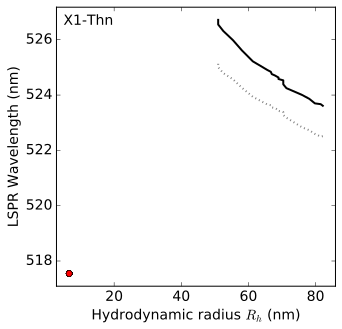

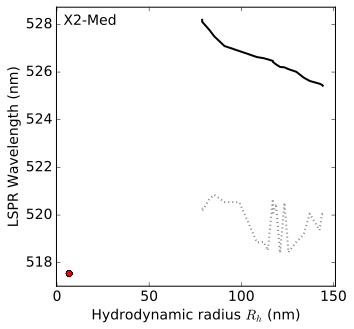

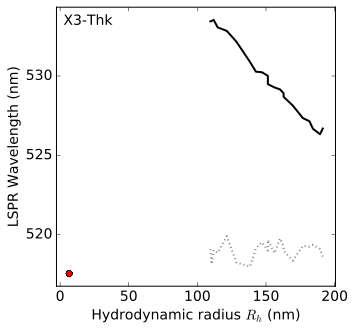

In [79]:
exportFlag = False
print('All samples: peak LSPR wavelength vs  hydrodynamic radius')
print('================================================')
print('Power law baseline corrected for scattering')
print('Individually with Au core in red for reference')
def plotAndSave (sampleNum):   
    sampleLabel = ['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]

    # data set 1
    label = 'corr.'
    color = 'black'
    marker = ''
    line = '-'
    x, y = plotArray[:,-2], plotArray[:,0]
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 2
    label = 'uncorr.'
    color = 'gray'
    marker = ''
    line = ':'
    x, y = plotArray[:,-2], plotArray[:,1]
    if max(y) > 0:
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    # data set 3
    label = 'Au core'
    color = 'red'
    marker = 'o'
    line = ''
    if sampleNum < 3: 
        plotArray = lsprPeakWLnmCoreList[0]
        Rnm = coreRnms[0]
    else: 
        plotArray = lsprPeakWLnmCoreList[1]
        Rnm = coreRnms[1]
    x, y = [], []
    for T in xs[0]: x.append(Rnm); y.append(plotArray[0])
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    figText = sampleLabel
    pylab.text(xLimits[0]+0.025*dx, yLimits[1]-0.025*dy, figText, verticalalignment='top', horizontalalignment='left')
#     pylab.legend(loc='upper left', bbox_to_anchor=(1.05,1), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ( "_lspr-vs-Rh_powr-corr_" + sampleLabel )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
for sampleNum in range(6):
    plotAndSave(sampleNum) 


### Together with cores

All samples: peak LSPR wavelength vs hydrodynamic radius
Power law baseline corrected for scattering
Together with Au cores in black/gray for reference
Exported to:
 graphics/20170303_lspr-vs-Rh_powr-corr_all.svg


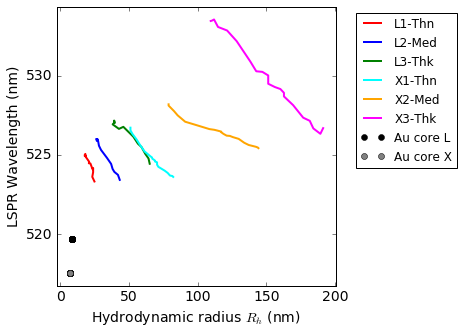

In [26]:
print('All samples: peak LSPR wavelength vs hydrodynamic radius')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together with Au cores in black/gray for reference')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,0]
        if (x.size > 0) & (max(y) > 0):
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='upper left', bbox_to_anchor=(1.05,1), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-Rh_powr-corr_all" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores

All samples: peak LSPR wavelength vs hydrodynamic radius
Power law baseline corrected for scattering
Together without Au cores


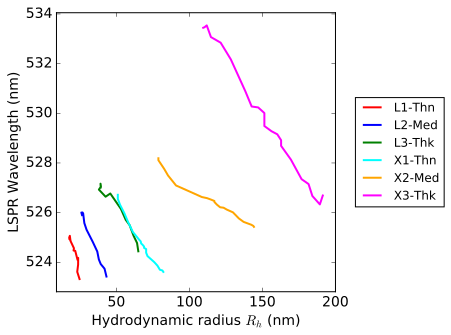

In [80]:
exportFlag = False
print('All samples: peak LSPR wavelength vs hydrodynamic radius')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together without Au cores')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = ['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,0]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-Rh_powr-corr_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together with cores, compared to uncorrected

All samples: peak LSPR wavelength vs hydrodynamic radius
Power law baseline corrected for scattering
Together without Au cores


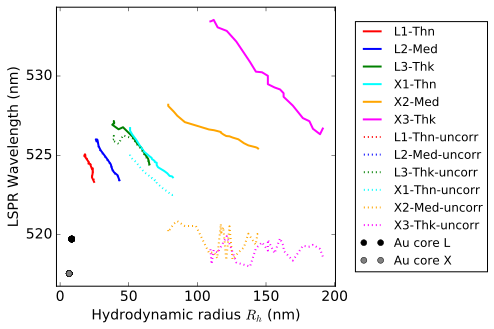

In [82]:
exportFlag = False
print('All samples: peak LSPR wavelength vs hydrodynamic radius')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together without Au cores')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,0]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]) + '-uncorr'
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = ':'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,1]
        if max(y) > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
        
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.plot(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)- 0.05*dy, np.amax(y)+ 0.05*dy]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.xlabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.ylabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05, 0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_lspr-vs-Rh_powr-corr_compare_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

## Hydrodynamic radius vs peak wavelength plots

In [83]:
for sampleNum in range(6):
    rCorenm = coreRnms[0]
    if sampleNum > 2: rCorenm = coreRnms[1]
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]
    x = plotArray[:,-2]
    print(sampleNum, min(np.round(x,1)), max(np.round(x,1)))

0 17.7 24.8
1 26.0 43.2
2 38.0 65.0
3 51.0 82.2
4 78.8 144.2
5 109.5 191.4


### Together with cores

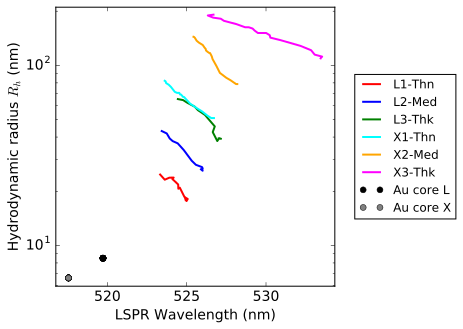

In [84]:
exportFlag = False
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,0]
        if (x.size > 0) & (max(y) > 0):
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(ys[setNum], xs[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(ys[setNum][i]); y.append(xs[setNum][i])
    y.append(np.min(spectraRhnms[0]))
    y.append(np.max(spectraRhnms[-1]))
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)*.9, np.amax(y)*1.1]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.xlabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05,0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    # pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_Rh-vs-lspr_powr-corr_all" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together without cores

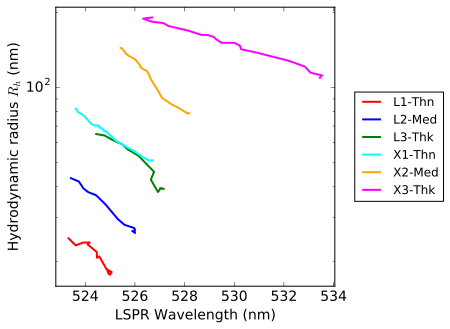

In [85]:
exportFlag = False
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = ['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,0]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(ys[setNum], xs[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(ys[setNum][i]); y.append(xs[setNum][i])
    y.append(np.min(spectraRhnms[0]))
    y.append(np.max(spectraRhnms[-1]))
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)*.9, np.amax(y)*1.1]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.xlabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05,0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    #pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_Rh-vs-lspr_powr-corr_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### Together with cores, compared to uncorrected

All samples: peak LSPR wavelength vs hydrodynamic radius
Power law baseline corrected for scattering
Together without Au cores


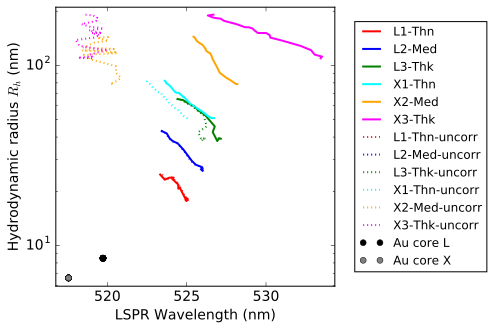

In [86]:
exportFlag = False
print('All samples: peak LSPR wavelength vs hydrodynamic radius')
print('================================================')
print('Power law baseline corrected for scattering')
print('Together without Au cores')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,0]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum]) + '-uncorr'
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = ':'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        x, y = plotArray[:,-2], plotArray[:,1]
        if max(y) > 0:
            xs.append(x), ys.append(y), labels.append(label), 
            colors.append(color), markers.append(marker), lines.append(line)
            sampleLabels.append(label)
    
    # data set 2
    for coreNum in range(2):
        label = (['Au core L', 'Au core X'][coreNum])
        color = (['black','gray'][coreNum])
        marker = 'o'
        line = ''
        plotArray = lsprPeakWLnmCoreList[coreNum]
        Rnm = coreRnms[coreNum]
        x, y = [], []
        for T in xs[3]: x.append(Rnm); y.append(plotArray[0])
        xs.append(x), ys.append(y), labels.append(label)
        colors.append(color), markers.append(marker), lines.append(line)
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(ys[setNum], xs[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(ys[setNum][i]); y.append(xs[setNum][i])
    y.append(np.min(spectraRhnms[0]))
    y.append(np.max(spectraRhnms[-1]))
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)*0.9, np.amax(y)*1.1]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.xlabel("LSPR Wavelength (nm)")
    pylab.legend(loc='center left', bbox_to_anchor=(1.05,0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    #pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_Rh-vs-lspr_powr-corr_compare_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

## Scattering exponent plots

### Rh vs scattering exponent k

All samples
Power law baseline corrected for scattering


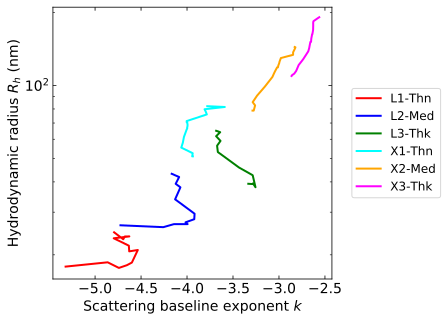

In [17]:
exportFlag = False
print('All samples')
print('================================================')
print('Power law baseline corrected for scattering')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        y = plotArray[:,-2]
        plotArray = np.asarray(lsprPowrBaselinenkList)[selection]
        x = plotArray[:,1]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    y.append(np.min(spectraRhnms[0]))
    y.append(np.max(spectraRhnms[-1]))
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)*0.9, np.amax(y)*1.1]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('Hydrodynamic radius $R_h$ (nm)')
    pylab.xlabel('Scattering baseline exponent $k$')
    pylab.legend(loc='center left', bbox_to_anchor=(1.05,0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    #pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_Rh-vs-lspr_powr-corr_compare_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

### $R_h/\lambda$ vs scattering exponent k

All samples
Power law baseline corrected for scattering


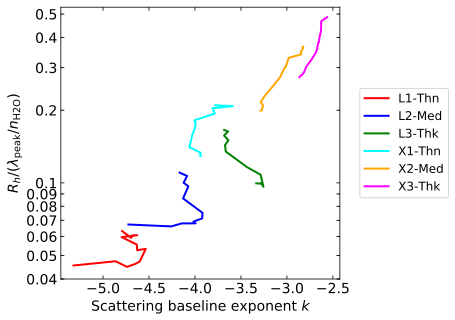

In [30]:
exportFlag = False
print('All samples')
print('================================================')
print('Power law baseline corrected for scattering')
def plotAndSave ():   
    
    # data sets
    sampleLabels = []
    xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
    for sampleNum in range(6):
        label = (['L1-Thn','L2-Med','L3-Thk','X1-Thn','X2-Med','X3-Thk'][sampleNum])
        color = (['red','blue','green','cyan','orange','magenta'][sampleNum])
        marker = '' #(['o','s','v','d','*','>'][sampleNum])
        line = '-'
        selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
        plotArray = lsprPowrPeakWLnmArray[selection]
        riPeakArray = np.array([ri.nH2O(wlnm).real for wlnm in plotArray[:,0]])
        y = plotArray[:,-2]/(plotArray[:,0]/riPeakArray)
        plotArray = np.asarray(lsprPowrBaselinenkList)[selection]
        x = plotArray[:,1]
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)
        sampleLabels.append(label)
    
    
    ## Plot lines & set limits
    nSets = len(xs)
    for setNum in range(nSets):
        pylab.semilogy(xs[setNum], ys[setNum], label=labels[setNum], 
                   color=colors[setNum], linestyle=lines[setNum], marker=markers[setNum], 
                   linewidth=2)
    x, y = [], []
    for setNum in range(nSets):
        for i in range(len(xs[setNum])): 
            x.append(xs[setNum][i]); y.append(ys[setNum][i])
    xLimits = [np.amin(x), np.amax(x)]
    yLimits = [np.amin(y), np.amax(y)]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    xLimits = [np.amin(x)- 0.05*dx, np.amax(x)+ 0.05*dx]
    yLimits = [np.amin(y)*0.9, np.amax(y)*1.1]
    dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])
    
    ## Specific format options
    pylab.ylabel('$R_h/(\lambda_{\mathrm{peak}}/n_{\mathrm{H2O}})$')
    pylab.xlabel('Scattering baseline exponent $k$')
    pylab.legend(loc='center left', bbox_to_anchor=(1.05,0.5), fontsize=12)
    
    ## More general format options
    aspectRatio = dx/dy
    figWidthcm = [8.46, 17.78][0] # ACS 1- and 2- column sizes
    figSizein = [figWidthcm/2.54, aspectRatio*figWidthcm/2.54]
    fig = pylab.figure(1, figsize=(figSizein[0],figSizein[1]))
    pylab.subplot(111)
    pylab.rcParams.update({'font.size': 14})
    #pylab.axes().set_aspect(aspectRatio)
    pylab.xlim(xLimits[0], xLimits[1])
    pylab.ylim(yLimits[0], yLimits[1])
    pylab.locator_params(axis='x', nbins=7)
    yticks = np.concatenate((np.arange(0.04, 0.1, 0.01), np.arange(0.1, 0.6, 0.1)))
    pylab.yticks(yticks, yticks)
    
    ## Save and display
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = ("_Rh-vs-lspr_powr-corr_compare_all-no-cores" )
    filename = "graphics/" + timestamp + identifier + exportFormat
    if (exportFlag): pylab.savefig(filename); print("Exported to:\n", filename)
    pylab.show()
    
plotAndSave()

## Summary, mean

In [89]:
print('Mean Orig Peak (nm)\t', 'Mean Corr Peak (nm)','\t', 'Orig WL shift (nm)','\t', 'Corr WL shift (nm)','\t', 'Mean diff (orig-corr) (nm)','\t', 'dRh/Rh collapsed (corr)')
for sampleNum in range(6):
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]
    wlavg = np.round(np.mean(plotArray[:,1]), decimals=2)
    wlcorravg = np.round(np.mean(plotArray[:,0]), decimals=2)
    dwl = np.round(np.max(plotArray[:,1]) - np.min(plotArray[:,1]), decimals=2)
    dwlcorr = np.round(np.max(plotArray[:,0]) - np.min(plotArray[:,0]), decimals=2)
    dcorr = np.round(np.mean(plotArray[:,0]-plotArray[:,1]), decimals=2)
    dRh = np.round( (np.max(plotArray[:,-3])-np.min(plotArray[:,-3]))/(np.min(plotArray[:,-3])), decimals=2)
    dRhoverRcore = np.round( (np.max(plotArray[:,-3])-np.min(plotArray[:,-3]))/(coreRnms[0]), decimals=2)
    if sampleNum > 3: dRhoverRcore = np.round( (np.max(plotArray[:,-3])-np.min(plotArray[:,-3]))/(coreRnms[1]), decimals=2)
    print(wlavg,'  \t\t', wlcorravg,'  \t\t', dwl,'   \t\t', dwlcorr,'  \t\t', dcorr,'  \t\t\t', dRh,'   \t\t\t', dRhoverRcore)

Mean Orig Peak (nm)	 Mean Corr Peak (nm) 	 Orig WL shift (nm) 	 Corr WL shift (nm) 	 Mean diff (orig-corr) (nm) 	 dRh/Rh collapsed (corr)
524.47   		 524.41   		 1.68    		 1.74   		 -0.06   			 3.0    			 5.29
524.98   		 525.02   		 2.6    		 2.58   		 0.03   			 3.0    			 5.29
525.61   		 526.1   		 1.89    		 2.72   		 0.49   			 2.67    			 4.71
523.59   		 524.82   		 2.65    		 3.11   		 1.24   			 6.34    			 5.71
519.78   		 526.52   		 2.44    		 2.76   		 6.74   			 6.34    			 7.35
519.02   		 529.89   		 1.91    		 7.21   		 10.88   			 6.34    			 7.35


# Formatted plots

## Shell-to-core ratio ($R_h/R_{\mathrm{core}}$) vs peak wavelength plot

### Formatted: together with cores, compared to uncorrected

Exported to:
 graphics/20170321_Rh-ratio-vs-peak-wl-nm_85mm.svg
Exported to:
 graphics/20170321_Rh-ratio-vs-peak-wl-nm_63.5mm.svg


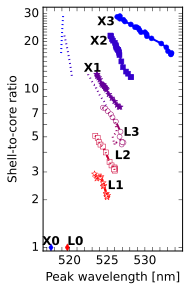

In [60]:
exportFlag = True
pylab.cla()

colorList = ['#ff0000','#cc0035','#990066','#660099','#3300cc','#0000ff']
labelList = ['L1','L2','L3','X1','X2','X3']

# data sets
sampleLabels = []
xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
for sampleNum in range(6):
    rCorenm = coreRnms[0]
    if sampleNum > 2: rCorenm = coreRnms[1]
    label = (labelList[sampleNum])
    color = (colorList[sampleNum])
    marker = (['*','s','o','*','s','o'][sampleNum])
    line = '-'
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]
    x, y = plotArray[:,0], plotArray[:,-2]
    y = np.log((y/rCorenm))
    xs.append(x), ys.append(y), labels.append(label), 
    colors.append(color), markers.append(marker), lines.append(line)

for sampleNum in range(6):
    rCorenm = coreRnms[0]
    if sampleNum > 2: rCorenm = coreRnms[1]
    label = (labelList[sampleNum])
    color = (colorList[sampleNum])
    marker = '' 
    line = ':'
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]    
    x, y = plotArray[:,1], plotArray[:,-2]
    if (sampleNum > 3):
        m, b = np.polyfit(y, x, 1)
        x = [m*yi + b for yi in y]
    y = np.log((y/rCorenm))
    if max(y) > 0:
        xs.append(x), ys.append(y), labels.append(label), 
        colors.append(color), markers.append(marker), lines.append(line)

for coreNum in range(2):
    label = (['L0', 'X0'][coreNum])
    color = (['red','blue'][coreNum])
    marker = 'd'
    line = ''
    x, y = lsprPeakWLnmCoreList[coreNum][0], np.log([1])
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)


## Plot lines & set limits
ax = pylab.gca()
nSets = len(xs)
for setNum in range(nSets):
    fc, ms = 'white', 5
    if setNum > 2: fc = colors[setNum]
    if setNum in [0,3]: ms = 6.5
    ax.plot(xs[setNum], ys[setNum], label=labels[setNum], color=colors[setNum] 
               , linestyle=lines[setNum], marker=markers[setNum] 
               , markeredgewidth=0.5, markeredgecolor=colors[setNum]
               , markerfacecolor=fc, markersize=ms
               , linewidth=2)
x, y = [], []
# for setNum in range(nSets):
#     for i in range(len(xs[setNum])): 
#         x.append(ys[setNum][i]); y.append(xs[setNum][i])
# xLimits = [np.amin(x), np.amax(x)]
# yLimits = [np.amin(y), np.amax(y)]
# dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])

## Text and sizing
pylab.ylabel('Shell-to-core ratio')
pylab.xlabel("Peak wavelength [nm]")

xlim = ax.set_xlim([516.5, 535])
xticks = np.arange(517, 535)
xticklabels = xticks.astype(int).astype(str)
xtickslabeled = np.arange(520, 535, 5)
for i in range(len(xticks)): 
    if (xticks[i] not in xtickslabeled): xticklabels[i] = ''
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels)
xlim = ax.set_xlim()

ylim = ax.set_ylim(np.log([0.95,33]))
yticks = np.arange(1, 31, 1)
yticklabels = (yticks.astype(int)).astype(str)
ytickslabeled = [1, 2, 3, 5, 7, 10, 20, 30]
for i in range(len(yticks)): 
    if (yticks[i] not in ytickslabeled): yticklabels[i] = ''
yticks = np.log(yticks)
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels)
ylim = ax.set_ylim() 

posx = max(xs[0])
posy = np.mean(ys[0])
ax.text(posx, posy, labels[0], ha='left', va='center', weight='bold')

posx = max(xs[1])
posy = np.mean(ys[1][ (ys[1] < min(ys[2])) ])
ax.text(posx, posy, labels[1], ha='left', va='bottom', weight='bold')

posx = max(xs[2])
posy = np.mean(ys[2])
ax.text(posx, posy, labels[2], ha='left', va='top', weight='bold')

posx = 0.5*(min(xs[3]) + min(xs[9]))
posy = max(ys[3])
ax.text(posx, posy, labels[3], ha='center', va='bottom', weight='bold')

posx = (0.75*min(xs[4]) + 0.25*min(xs[10]))
posy = max(ys[4])
ax.text(posx, posy, labels[4], ha='center', va='top', weight='bold')

posx = (0.8*min(xs[5]) + 0.2*min(xs[11]))
posy = max(ys[5])
ax.text(posx, posy, labels[5], ha='center', va='top', weight='bold')

posx = xs[-2]
posy = ys[-2]
ax.text(posx, posy, labels[-2], ha='left', va='bottom', weight='bold')

posx = xs[-1]
posy = ys[-1]
ax.text(posx, posy, labels[-1], ha='center', va='bottom', weight='bold')

width, height = 51.5, 90
aspect_ratio = width/height
aspect = ( (xlim[1]-xlim[0])/(ylim[1]-ylim[0]) )/aspect_ratio
ax.set_aspect(aspect)



## Save and display
if (exportFlag):
    fig = pylab.gcf()
    wmmList = [85, 63.5]
    matplotlib.rcParams['svg.fonttype'] = 'none'
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = '_Rh-ratio-vs-peak-wl-nm'
    folder = 'graphics/'
    for wmm in wmmList:
        fig.set_size_inches(wmm/25.4, (1/aspect_ratio)*wmm/25.4)
        fontSize = min([int(ceil(wmm/5.7)), 12])
        matplotlib.rcParams.update({'font.size': fontSize})
        for text in fig.texts:
            text.set_fontsize(fontSize)
        sizeName = '_' + str(wmm) + 'mm'
        filename = folder + timestamp + identifier + sizeName + exportFormat
        plt.savefig(filename, transparent=True); print("Exported to:\n", filename)

plt.show()

if (exportFlag): 
    matplotlib.rcParams['svg.fonttype'] = 'path'
    matplotlib.rcParams['font.size'] = 12



In [145]:
for sampleNum in range(6):
    rCorenm = coreRnms[0]
    if sampleNum > 2: rCorenm = coreRnms[1]
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]
    x = plotArray[:,-2]
    x = x/rCorenm
    print(sampleNum, min(np.round(x,1)), max(np.round(x,1)))

0 2.1 2.9
1 3.1 5.1
2 4.5 7.6
3 7.7 12.4
4 11.9 21.9
5 16.6 29.0


## Shell-to-core ratio (Rh/Rcore) vs gamma-scattering

$\gamma_{\mathrm{scat}}^{(400)} = \frac{C_{\mathrm{ext}}(\lambda_{\mathrm{peak}})/C_{\mathrm{ext}}(400{\mathrm{ nm}}) }{\left[C_{\mathrm{ext}}(\lambda_{\mathrm{peak}})/C_{\mathrm{ext}}(400{\mathrm{ nm}}) \right]_{\mathrm{core}}}$

### Formatted: uncorrected (without subtraction)

Exported to:
 graphics/20170321_Rh-ratio-vs-gamma-scat400_85mm.svg
Exported to:
 graphics/20170321_Rh-ratio-vs-gamma-scat400_63.5mm.svg


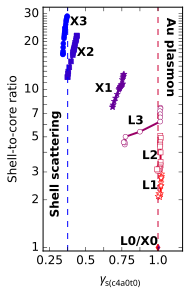

In [61]:
exportFlag = True
pylab.cla()

wlScatnm = 400
colorList = ['#ff0000','#cc0035','#990066','#660099','#3300cc','#0000ff']
labelList = ['L1','L2','L3','X1','X2','X3']

# data sets
sampleLabels = []
xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
for sampleNum in range(6):
    coreNum = 0
    if (sampleNum > 2): coreNum = 1
    rCorenm = coreRnms[coreNum]
    coreSpectrum = spectraCores[coreNum]
    wlPeakCorenm = lsprPeakWLnmCoreArray[coreNum][0]
    CextCoreRef = []
    for wlnm in [wlPeakCorenm, wlScatnm]:
        select = (np.abs(coreSpectrum[:,0] - wlnm) < 1)
        CextCoreRef.append(np.mean(coreSpectrum[select][:, -1]))
    gammaCoreRef = CextCoreRef[0]/CextCoreRef[1]
    
    plotArray = lsprPeakWLnmArray[(lsprPeakWLnmArray[:,-1] == sampleNum)]
    x, y = [], []
    for elem in plotArray:
        wlPeakCoreShellnm = elem[0]
        Rhnm = elem[-2]
        yi = np.log(Rhnm/rCorenm)
        coreShellSpectrum = dataArray[( (dataArray[:,-1] == sampleNum) & (dataArray[:,-2] == Rhnm) )][:,[0,1]]
        CextCoreShellRef = []
        for wlnm in [wlPeakCorenm, wlScatnm]:
            select = (np.abs(coreShellSpectrum[:,0] - wlnm) < 1)
            CextCoreShellRef.append(np.mean(coreShellSpectrum[select][:, -1]))
        gamma = (CextCoreShellRef[0]/CextCoreShellRef[1])/gammaCoreRef
        xi = gamma
        x.append(xi)
        y.append(yi)
    x, y = np.array(x), np.array(y)
    
    label = (labelList[sampleNum])
    color = (colorList[sampleNum])
    marker = (['*','s','o','*','s','o'][sampleNum])
    line = '-'
    xs.append(x), ys.append(y), labels.append(label), 
    colors.append(color), markers.append(marker), lines.append(line)


for coreNum in range(1):
    label = (['L0/X0'][coreNum])
    color = (['red'][coreNum])
    marker = 'd'
    line = ''
    x, y = [1.0], np.log([1.0])
    xs.append(x), ys.append(y), labels.append(label)
    colors.append(color), markers.append(marker), lines.append(line)


## Plot lines & set limits
ax = pylab.gca()
nSets = len(xs)
for setNum in range(nSets):
    fc, ms = 'white', 5
    if setNum > 2: fc = colors[setNum]
    if setNum in [0,3]: ms = 6.5
    fs = matplotlib.lines.Line2D.fillStyles[0]
    if setNum > 5: fs = matplotlib.lines.Line2D.fillStyles[1]
    ax.plot(xs[setNum], ys[setNum], label=labels[setNum], color=colors[setNum] 
               , linestyle=lines[setNum], marker=markers[setNum] 
               , markeredgewidth=0.5, markeredgecolor=colors[setNum]
               , markerfacecolor=fc, markersize=ms, fillstyle=fs
               , markerfacecoloralt='blue' # for core diamond marker
               , linewidth=2)
x, y = [], []
# for setNum in range(nSets):
#     for i in range(len(xs[setNum])): 
#         x.append(ys[setNum][i]); y.append(xs[setNum][i])
# xLimits = [np.amin(x), np.amax(x)]
# yLimits = [np.amin(y), np.amax(y)]
# dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])

## Text and sizing
pylab.ylabel('Shell-to-core ratio')
pylab.xlabel('$γ_{\mathrm{scat}}^{(400)}$')

xlim = ax.set_xlim([0.2, 1.15])
xticks = np.arange(0.25, 1.1, 0.125)
xticklabels = np.round(xticks,2).astype(str)
for i in range(1,len(xticks)-1,2): xticklabels[i] = ''
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels)
xlim = ax.set_xlim()

ylim = ax.set_ylim(np.log([0.95,33]))
yticks = np.arange(1, 31, 1)
yticklabels = (yticks.astype(int)).astype(str)
ytickslabeled = [1, 2, 3, 5, 7, 10, 20, 30]
for i in range(len(yticks)): 
    if (yticks[i] not in ytickslabeled): yticklabels[i] = ''
yticks = np.log(yticks)
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels)
ylim = ax.set_ylim() 

gamma1 = 1
ax.plot(gamma1*np.ones_like(ylim), ylim, '--', color=colorList[1], linewidth=1)
gamma0 = 0.375
ax.plot(gamma0*np.ones_like(ylim), ylim, '--', color=colorList[-1], linewidth=1)
xlim = ax.set_xlim([gamma0 - 0.17, gamma1 + 0.17])

posx = 1
posy = np.mean(ys[0])
ax.text(posx, posy, labels[0], ha='right', va='center', weight='bold')

posx = 1
posy = np.mean(ys[1][ (ys[1] < min(ys[2])) ])
ax.text(posx, posy, labels[1], ha='right', va='bottom', weight='bold')

posx = np.mean(xs[2])
posy = np.mean(ys[2])
ax.text(posx, posy, labels[2], ha='right', va='bottom', weight='bold')

posx = min(xs[3])
posy = np.mean(ys[3])
ax.text(posx, posy, labels[3], ha='right', va='center', weight='bold')

posx = max(xs[4])
posy = np.mean(ys[4])
ax.text(posx, posy, labels[4], ha='left', va='center', weight='bold')

posx = 1.05*max(xs[5])
posy = max(ys[5])
ax.text(posx, posy, labels[5], ha='left', va='top', weight='bold')

posx = xs[-1][0]
posy = ys[-1][0]
ax.text(posx, posy, labels[-1], ha='right', va='bottom', weight='bold')

ax.text(np.mean([gamma1, xlim[1]]), np.mean([ys[2][0], ylim[1]]), 'Au plasmon', 
        ha='center', va='center', weight='bold', rotation=270)

ax.text(np.mean([gamma0, xlim[0]]), np.mean([ys[4][-1], ylim[0]]), 'Shell scattering', 
        ha='center', va='center', weight='bold', rotation=90)

width, height = 51.5, 90
aspect_ratio = width/height
aspect = ( (xlim[1]-xlim[0])/(ylim[1]-ylim[0]) )/aspect_ratio
ax.set_aspect(aspect)


## Save and display
if (exportFlag):
    fig = pylab.gcf()
    wmmList = [85, 63.5]
    matplotlib.rcParams['svg.fonttype'] = 'none'
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = '_Rh-ratio-vs-gamma-scat400'
    folder = 'graphics/'
    for wmm in wmmList:
        fig.set_size_inches(wmm/25.4, (1/aspect_ratio)*wmm/25.4)
        fontSize = min([int(ceil(wmm/5.7)), 12])
        matplotlib.rcParams.update({'font.size': fontSize})
        for text in fig.texts:
            text.set_fontsize(fontSize)
        sizeName = '_' + str(wmm) + 'mm'
        filename = folder + timestamp + identifier + sizeName + exportFormat
        plt.savefig(filename, transparent=True); print("Exported to:\n", filename)

pylab.show()

if (exportFlag): 
    matplotlib.rcParams['svg.fonttype'] = 'path'
    matplotlib.rcParams['font.size'] = 12



## Shell-to-core ratio (Rh/Rcore) vs scattering exponent k

Scattering background is fit to a power-law between 400 and 800 nm.  
$C_{\mathrm{sca}} = C_0 (\lambda/\lambda_0)^k$

Exported to:
 graphics/20170327_Rh-ratio-vs-scat-exponent-k_85mm.svg
Exported to:
 graphics/20170327_Rh-ratio-vs-scat-exponent-k_63.5mm.svg


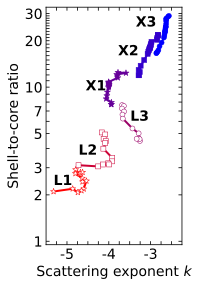

In [50]:
exportFlag = True
pylab.cla()

colorList = ['#ff0000','#cc0035','#990066','#660099','#3300cc','#0000ff']
labelList = ['L1','L2','L3','X1','X2','X3']

# data sets
sampleLabels = []
xs, ys, labels, colors, markers, lines = [], [], [], [], [], []
for sampleNum in range(6):
    rCorenm = coreRnms[0]
    if sampleNum > 2: rCorenm = coreRnms[1]
    label = (labelList[sampleNum])
    color = (colorList[sampleNum])
    marker = (['*','s','o','*','s','o'][sampleNum])
    line = '-'
    selection = (lsprPowrPeakWLnmArray[:,-1] == sampleNum)
    plotArray = lsprPowrPeakWLnmArray[selection]
    x, y = plotArray[:,0], plotArray[:,-2]
    y = np.log((y/rCorenm))
    plotArray = np.asarray(lsprPowrBaselinenkList)[selection]
    x = plotArray[:,1]
    xs.append(x), ys.append(y), labels.append(label), 
    colors.append(color), markers.append(marker), lines.append(line)


## Plot lines & set limits
ax = pylab.gca()
nSets = len(xs)
for setNum in range(nSets):
    fc, ms = 'white', 5
    if setNum > 2: fc = colors[setNum]
    if setNum in [0,3]: ms = 6.5
    ax.plot(xs[setNum], ys[setNum], label=labels[setNum], color=colors[setNum] 
               , linestyle=lines[setNum], marker=markers[setNum] 
               , markeredgewidth=0.5, markeredgecolor=colors[setNum]
               , markerfacecolor=fc, markersize=ms
               , linewidth=2)
x, y = [], []
# for setNum in range(nSets):
#     for i in range(len(xs[setNum])): 
#         x.append(ys[setNum][i]); y.append(xs[setNum][i])
# xLimits = [np.amin(x), np.amax(x)]
# yLimits = [np.amin(y), np.amax(y)]
# dx, dy = abs(xLimits[1]-xLimits[0]), abs(yLimits[1]-yLimits[0])

## Text and sizing
pylab.ylabel('Shell-to-core ratio')
pylab.xlabel('Scattering exponent $k$')

xlim = ax.set_xlim([-5.5, -2.25])
xticks = np.round(np.arange(-5.25, -2.25, 0.25),2)
xticklabels = xticks.astype(int).astype(str)
xtickslabeled = np.round(np.arange(-5, -2.5, 1),2)
for i, xtick in enumerate(xticks): 
    if (xtick not in xtickslabeled): xticklabels[i] = ''
ax.set_xticks(xticks)
ax.set_xticklabels(xticklabels)
xlim = ax.set_xlim()

ylim = ax.set_ylim(np.log([0.95,33]))
yticks = np.arange(1, 31, 1)
yticklabels = (yticks.astype(int)).astype(str)
ytickslabeled = [1, 2, 3, 5, 7, 10, 20, 30]
for i in range(len(yticks)): 
    if (yticks[i] not in ytickslabeled): yticklabels[i] = ''
yticks = np.log(yticks)
ax.set_yticks(yticks)
ax.set_yticklabels(yticklabels)
ylim = ax.set_ylim() 

posx = min(xs[0])
posy = np.mean(ys[0])
ax.text(posx, posy, labels[0], ha='left', va='center', weight='bold')

posx = min(xs[1])
posy = np.mean(ys[1][ (ys[1] < min(ys[2])) ])
ax.text(posx, posy, labels[1], ha='left', va='bottom', weight='bold')

posx = np.mean(xs[2])
posy = np.mean(ys[2])
ax.text(posx, posy, labels[2], ha='left', va='bottom', weight='bold')

posx = min(xs[3])
posy = np.mean(ys[3])
ax.text(posx, posy, labels[3], ha='right', va='center', weight='bold')

posx = min(xs[4])
posy = np.mean(ys[4])
ax.text(posx, posy, labels[4], ha='right', va='center', weight='bold')

posx = min(xs[5])
posy = max(ys[5])
ax.text(posx, posy, labels[5], ha='right', va='top', weight='bold')

width, height = 51.5, 90
aspect_ratio = width/height
aspect = ( (xlim[1]-xlim[0])/(ylim[1]-ylim[0]) )/aspect_ratio
ax.set_aspect(aspect)



## Save and display
if (exportFlag):
    fig = pylab.gcf()
    wmmList = [85, 63.5]
    matplotlib.rcParams['svg.fonttype'] = 'none'
    timestamp = ('{:%Y%m%d}'.format(datetime.datetime.now()))
    exportFormat = '.svg'
    identifier = '_Rh-ratio-vs-scat-exponent-k'
    folder = 'graphics/'
    for wmm in wmmList:
        fig.set_size_inches(wmm/25.4, (1/aspect_ratio)*wmm/25.4)
        fontSize = min([int(ceil(wmm/5.7)), 12])
        matplotlib.rcParams.update({'font.size': fontSize})
        for text in fig.texts:
            text.set_fontsize(fontSize)
        sizeName = '_' + str(wmm) + 'mm'
        filename = folder + timestamp + identifier + sizeName + exportFormat
        plt.savefig(filename, transparent=True); print("Exported to:\n", filename)

pylab.show()

if (exportFlag): 
    matplotlib.rcParams['svg.fonttype'] = 'path'
    matplotlib.rcParams['font.size'] = 12



### Formatted